# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
asdp_1 = adata.X.sum()

In [7]:
ratio_true=0.99

from tardis._utils.functions import create_random_mask
mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [8]:
asdp_2 = adata.X.sum()

In [9]:
mask.sum()/adata.shape[1],  1-asdp_2/asdp_1

(0.9918, 0.9928624471649528)

In [10]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [11]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [12]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/work/codes/tardis/tardis/_mymodel.py:81: UserWarning: This dataset has some empty cells, this might fail inference.Data should be filtered with `scanpy.pp.filter_cells()`
  library_log_means, library_log_vars = _init_library_size(self.adata_manager, n_batch)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: juvy9ohs
Name: forgotten-council-137
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/juvy9ohs
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155911-juvy9ohs/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2543,3247,9453
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2543,2540,1698,3422,1649,3391
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4490,10753
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 662,862,2286
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 662,662,410,868,400,808
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1094,2716
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:13:18, 13.35s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:13:18, 13.35s/it, v_num=hs_1, total_loss_train=67.3, kl_local_train=40.5]

Epoch 2/600:   0%|          | 1/600 [00:13<2:13:18, 13.35s/it, v_num=hs_1, total_loss_train=67.3, kl_local_train=40.5]

Epoch 2/600:   0%|          | 2/600 [00:25<2:05:32, 12.60s/it, v_num=hs_1, total_loss_train=67.3, kl_local_train=40.5]

Epoch 2/600:   0%|          | 2/600 [00:25<2:05:32, 12.60s/it, v_num=hs_1, total_loss_train=34.3, kl_local_train=64.2]

Epoch 3/600:   0%|          | 2/600 [00:25<2:05:32, 12.60s/it, v_num=hs_1, total_loss_train=34.3, kl_local_train=64.2]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:05, 12.37s/it, v_num=hs_1, total_loss_train=34.3, kl_local_train=64.2]

Epoch 3/600:   0%|          | 3/600 [00:37<2:03:05, 12.37s/it, v_num=hs_1, total_loss_train=29.2, kl_local_train=59]  

Epoch 4/600:   0%|          | 3/600 [00:37<2:03:05, 12.37s/it, v_num=hs_1, total_loss_train=29.2, kl_local_train=59]

Epoch 4/600:   1%|          | 4/600 [00:49<2:01:32, 12.24s/it, v_num=hs_1, total_loss_train=29.2, kl_local_train=59]

Epoch 4/600:   1%|          | 4/600 [00:49<2:01:32, 12.24s/it, v_num=hs_1, total_loss_train=28, kl_local_train=43.6]

Epoch 5/600:   1%|          | 4/600 [00:49<2:01:32, 12.24s/it, v_num=hs_1, total_loss_train=28, kl_local_train=43.6]

Epoch 5/600:   1%|          | 5/600 [01:01<2:01:41, 12.27s/it, v_num=hs_1, total_loss_train=28, kl_local_train=43.6]

Epoch 5/600:   1%|          | 5/600 [01:01<2:01:41, 12.27s/it, v_num=hs_1, total_loss_train=27.6, kl_local_train=26.8]

Epoch 6/600:   1%|          | 5/600 [01:03<2:01:41, 12.27s/it, v_num=hs_1, total_loss_train=27.6, kl_local_train=26.8]

Epoch 6/600:   1%|          | 6/600 [01:14<2:04:10, 12.54s/it, v_num=hs_1, total_loss_train=27.6, kl_local_train=26.8]

Epoch 6/600:   1%|          | 6/600 [01:14<2:04:10, 12.54s/it, v_num=hs_1, total_loss_train=27.3, kl_local_train=14.8, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 6/600 [01:14<2:04:10, 12.54s/it, v_num=hs_1, total_loss_train=27.3, kl_local_train=14.8, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:27<2:03:16, 12.47s/it, v_num=hs_1, total_loss_train=27.3, kl_local_train=14.8, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:27<2:03:16, 12.47s/it, v_num=hs_1, total_loss_train=27.1, kl_local_train=9.43, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|          | 7/600 [01:27<2:03:16, 12.47s/it, v_num=hs_1, total_loss_train=27.1, kl_local_train=9.43, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [01:39<2:02:47, 12.44s/it, v_num=hs_1, total_loss_train=27.1, kl_local_train=9.43, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [01:39<2:02:47, 12.44s/it, v_num=hs_1, total_loss_train=34.8, kl_local_train=7.35, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 9/600:   1%|▏         | 8/600 [01:39<2:02:47, 12.44s/it, v_num=hs_1, total_loss_train=34.8, kl_local_train=7.35, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [01:51<2:02:09, 12.40s/it, v_num=hs_1, total_loss_train=34.8, kl_local_train=7.35, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [01:51<2:02:09, 12.40s/it, v_num=hs_1, total_loss_train=42.3, kl_local_train=15.3, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 9/600 [01:51<2:02:09, 12.40s/it, v_num=hs_1, total_loss_train=42.3, kl_local_train=15.3, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:04<2:02:12, 12.43s/it, v_num=hs_1, total_loss_train=42.3, kl_local_train=15.3, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:04<2:02:12, 12.43s/it, v_num=hs_1, total_loss_train=46, kl_local_train=69.3, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]  

Epoch 11/600:   2%|▏         | 10/600 [02:05<2:02:12, 12.43s/it, v_num=hs_1, total_loss_train=46, kl_local_train=69.3, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:18<2:05:43, 12.81s/it, v_num=hs_1, total_loss_train=46, kl_local_train=69.3, metric_mi|status_control_train=0.0192, metric_mi|zone_train=0.00785, metric_mi|time_cat_train=0.0128, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:18<2:05:43, 12.81s/it, v_num=hs_1, total_loss_train=49.2, kl_local_train=84.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 12/600:   2%|▏         | 11/600 [02:18<2:05:43, 12.81s/it, v_num=hs_1, total_loss_train=49.2, kl_local_train=84.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 12/600:   2%|▏         | 12/600 [02:30<2:04:03, 12.66s/it, v_num=hs_1, total_loss_train=49.2, kl_local_train=84.5, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 12/600:   2%|▏         | 12/600 [02:30<2:04:03, 12.66s/it, v_num=hs_1, total_loss_train=53.8, kl_local_train=84, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]  

Epoch 13/600:   2%|▏         | 12/600 [02:30<2:04:03, 12.66s/it, v_num=hs_1, total_loss_train=53.8, kl_local_train=84, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 13/600:   2%|▏         | 13/600 [02:42<2:02:34, 12.53s/it, v_num=hs_1, total_loss_train=53.8, kl_local_train=84, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 13/600:   2%|▏         | 13/600 [02:42<2:02:34, 12.53s/it, v_num=hs_1, total_loss_train=57.3, kl_local_train=101, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 14/600:   2%|▏         | 13/600 [02:42<2:02:34, 12.53s/it, v_num=hs_1, total_loss_train=57.3, kl_local_train=101, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 14/600:   2%|▏         | 14/600 [02:54<2:01:43, 12.46s/it, v_num=hs_1, total_loss_train=57.3, kl_local_train=101, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 14/600:   2%|▏         | 14/600 [02:54<2:01:43, 12.46s/it, v_num=hs_1, total_loss_train=60.9, kl_local_train=123, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 15/600:   2%|▏         | 14/600 [02:55<2:01:43, 12.46s/it, v_num=hs_1, total_loss_train=60.9, kl_local_train=123, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 15/600:   2%|▎         | 15/600 [03:07<2:01:41, 12.48s/it, v_num=hs_1, total_loss_train=60.9, kl_local_train=123, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 15/600:   2%|▎         | 15/600 [03:07<2:01:41, 12.48s/it, v_num=hs_1, total_loss_train=64.8, kl_local_train=136, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 16/600:   2%|▎         | 15/600 [03:08<2:01:41, 12.48s/it, v_num=hs_1, total_loss_train=64.8, kl_local_train=136, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 16/600:   3%|▎         | 16/600 [03:21<2:04:40, 12.81s/it, v_num=hs_1, total_loss_train=64.8, kl_local_train=136, metric_mi|status_control_train=0.0966, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0534]

Epoch 16/600:   3%|▎         | 16/600 [03:21<2:04:40, 12.81s/it, v_num=hs_1, total_loss_train=68.8, kl_local_train=141, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]   

Epoch 17/600:   3%|▎         | 16/600 [03:21<2:04:40, 12.81s/it, v_num=hs_1, total_loss_train=68.8, kl_local_train=141, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 17/600:   3%|▎         | 17/600 [03:33<2:03:15, 12.69s/it, v_num=hs_1, total_loss_train=68.8, kl_local_train=141, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 17/600:   3%|▎         | 17/600 [03:33<2:03:15, 12.69s/it, v_num=hs_1, total_loss_train=73, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]  

Epoch 18/600:   3%|▎         | 17/600 [03:33<2:03:15, 12.69s/it, v_num=hs_1, total_loss_train=73, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 18/600:   3%|▎         | 18/600 [03:45<2:02:13, 12.60s/it, v_num=hs_1, total_loss_train=73, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 18/600:   3%|▎         | 18/600 [03:45<2:02:13, 12.60s/it, v_num=hs_1, total_loss_train=77.2, kl_local_train=144, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 19/600:   3%|▎         | 18/600 [03:45<2:02:13, 12.60s/it, v_num=hs_1, total_loss_train=77.2, kl_local_train=144, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 19/600:   3%|▎         | 19/600 [03:58<2:01:23, 12.54s/it, v_num=hs_1, total_loss_train=77.2, kl_local_train=144, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 19/600:   3%|▎         | 19/600 [03:58<2:01:23, 12.54s/it, v_num=hs_1, total_loss_train=81.3, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 20/600:   3%|▎         | 19/600 [03:58<2:01:23, 12.54s/it, v_num=hs_1, total_loss_train=81.3, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 20/600:   3%|▎         | 20/600 [04:10<2:00:51, 12.50s/it, v_num=hs_1, total_loss_train=81.3, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 20/600:   3%|▎         | 20/600 [04:10<2:00:51, 12.50s/it, v_num=hs_1, total_loss_train=85.5, kl_local_train=140, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 21/600:   3%|▎         | 20/600 [04:12<2:00:51, 12.50s/it, v_num=hs_1, total_loss_train=85.5, kl_local_train=140, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 21/600:   4%|▎         | 21/600 [04:24<2:04:15, 12.88s/it, v_num=hs_1, total_loss_train=85.5, kl_local_train=140, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 21/600:   4%|▎         | 21/600 [04:24<2:04:15, 12.88s/it, v_num=hs_1, total_loss_train=89.8, kl_local_train=139, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 22/600:   4%|▎         | 21/600 [04:24<2:04:15, 12.88s/it, v_num=hs_1, total_loss_train=89.8, kl_local_train=139, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 22/600:   4%|▎         | 22/600 [04:36<2:02:31, 12.72s/it, v_num=hs_1, total_loss_train=89.8, kl_local_train=139, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 22/600:   4%|▎         | 22/600 [04:36<2:02:31, 12.72s/it, v_num=hs_1, total_loss_train=93.9, kl_local_train=140, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 23/600:   4%|▎         | 22/600 [04:36<2:02:31, 12.72s/it, v_num=hs_1, total_loss_train=93.9, kl_local_train=140, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 23/600:   4%|▍         | 23/600 [04:49<2:01:37, 12.65s/it, v_num=hs_1, total_loss_train=93.9, kl_local_train=140, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 23/600:   4%|▍         | 23/600 [04:49<2:01:37, 12.65s/it, v_num=hs_1, total_loss_train=98.2, kl_local_train=141, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 24/600:   4%|▍         | 23/600 [04:49<2:01:37, 12.65s/it, v_num=hs_1, total_loss_train=98.2, kl_local_train=141, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 24/600:   4%|▍         | 24/600 [05:01<2:00:44, 12.58s/it, v_num=hs_1, total_loss_train=98.2, kl_local_train=141, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 24/600:   4%|▍         | 24/600 [05:01<2:00:44, 12.58s/it, v_num=hs_1, total_loss_train=102, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134] 

Epoch 25/600:   4%|▍         | 24/600 [05:01<2:00:44, 12.58s/it, v_num=hs_1, total_loss_train=102, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 25/600:   4%|▍         | 25/600 [05:14<2:00:27, 12.57s/it, v_num=hs_1, total_loss_train=102, kl_local_train=142, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 25/600:   4%|▍         | 25/600 [05:14<2:00:27, 12.57s/it, v_num=hs_1, total_loss_train=107, kl_local_train=137, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 26/600:   4%|▍         | 25/600 [05:15<2:00:27, 12.57s/it, v_num=hs_1, total_loss_train=107, kl_local_train=137, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 26/600:   4%|▍         | 26/600 [05:28<2:03:57, 12.96s/it, v_num=hs_1, total_loss_train=107, kl_local_train=137, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 26/600:   4%|▍         | 26/600 [05:28<2:03:57, 12.96s/it, v_num=hs_1, total_loss_train=111, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 27/600:   4%|▍         | 26/600 [05:28<2:03:57, 12.96s/it, v_num=hs_1, total_loss_train=111, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 27/600:   4%|▍         | 27/600 [05:40<2:02:03, 12.78s/it, v_num=hs_1, total_loss_train=111, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 27/600:   4%|▍         | 27/600 [05:40<2:02:03, 12.78s/it, v_num=hs_1, total_loss_train=115, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 28/600:   4%|▍         | 27/600 [05:40<2:02:03, 12.78s/it, v_num=hs_1, total_loss_train=115, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 28/600:   5%|▍         | 28/600 [05:52<2:00:49, 12.67s/it, v_num=hs_1, total_loss_train=115, kl_local_train=143, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 28/600:   5%|▍         | 28/600 [05:52<2:00:49, 12.67s/it, v_num=hs_1, total_loss_train=119, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 29/600:   5%|▍         | 28/600 [05:52<2:00:49, 12.67s/it, v_num=hs_1, total_loss_train=119, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 29/600:   5%|▍         | 29/600 [06:05<1:59:53, 12.60s/it, v_num=hs_1, total_loss_train=119, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 29/600:   5%|▍         | 29/600 [06:05<1:59:53, 12.60s/it, v_num=hs_1, total_loss_train=124, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 30/600:   5%|▍         | 29/600 [06:05<1:59:53, 12.60s/it, v_num=hs_1, total_loss_train=124, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 30/600:   5%|▌         | 30/600 [06:18<1:59:55, 12.62s/it, v_num=hs_1, total_loss_train=124, kl_local_train=145, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 30/600:   5%|▌         | 30/600 [06:18<1:59:55, 12.62s/it, v_num=hs_1, total_loss_train=128, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 31/600:   5%|▌         | 30/600 [06:19<1:59:55, 12.62s/it, v_num=hs_1, total_loss_train=128, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 31/600:   5%|▌         | 31/600 [06:31<2:03:08, 12.98s/it, v_num=hs_1, total_loss_train=128, kl_local_train=144, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 31/600:   5%|▌         | 31/600 [06:31<2:03:08, 12.98s/it, v_num=hs_1, total_loss_train=132, kl_local_train=147, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137] 

Epoch 32/600:   5%|▌         | 31/600 [06:31<2:03:08, 12.98s/it, v_num=hs_1, total_loss_train=132, kl_local_train=147, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 32/600:   5%|▌         | 32/600 [06:44<2:01:23, 12.82s/it, v_num=hs_1, total_loss_train=132, kl_local_train=147, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 32/600:   5%|▌         | 32/600 [06:44<2:01:23, 12.82s/it, v_num=hs_1, total_loss_train=136, kl_local_train=150, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 33/600:   5%|▌         | 32/600 [06:44<2:01:23, 12.82s/it, v_num=hs_1, total_loss_train=136, kl_local_train=150, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 33/600:   6%|▌         | 33/600 [06:56<2:00:08, 12.71s/it, v_num=hs_1, total_loss_train=136, kl_local_train=150, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 33/600:   6%|▌         | 33/600 [06:56<2:00:08, 12.71s/it, v_num=hs_1, total_loss_train=140, kl_local_train=151, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 34/600:   6%|▌         | 33/600 [06:56<2:00:08, 12.71s/it, v_num=hs_1, total_loss_train=140, kl_local_train=151, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 34/600:   6%|▌         | 34/600 [07:08<1:58:36, 12.57s/it, v_num=hs_1, total_loss_train=140, kl_local_train=151, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 34/600:   6%|▌         | 34/600 [07:08<1:58:36, 12.57s/it, v_num=hs_1, total_loss_train=145, kl_local_train=152, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 35/600:   6%|▌         | 34/600 [07:08<1:58:36, 12.57s/it, v_num=hs_1, total_loss_train=145, kl_local_train=152, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 35/600:   6%|▌         | 35/600 [07:21<1:58:21, 12.57s/it, v_num=hs_1, total_loss_train=145, kl_local_train=152, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 35/600:   6%|▌         | 35/600 [07:21<1:58:21, 12.57s/it, v_num=hs_1, total_loss_train=149, kl_local_train=150, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 36/600:   6%|▌         | 35/600 [07:22<1:58:21, 12.57s/it, v_num=hs_1, total_loss_train=149, kl_local_train=150, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 36/600:   6%|▌         | 36/600 [07:35<2:01:37, 12.94s/it, v_num=hs_1, total_loss_train=149, kl_local_train=150, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 36/600:   6%|▌         | 36/600 [07:35<2:01:37, 12.94s/it, v_num=hs_1, total_loss_train=153, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 37/600:   6%|▌         | 36/600 [07:35<2:01:37, 12.94s/it, v_num=hs_1, total_loss_train=153, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 37/600:   6%|▌         | 37/600 [07:47<2:00:08, 12.80s/it, v_num=hs_1, total_loss_train=153, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 37/600:   6%|▌         | 37/600 [07:47<2:00:08, 12.80s/it, v_num=hs_1, total_loss_train=157, kl_local_train=151, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 38/600:   6%|▌         | 37/600 [07:47<2:00:08, 12.80s/it, v_num=hs_1, total_loss_train=157, kl_local_train=151, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 38/600:   6%|▋         | 38/600 [08:00<1:58:56, 12.70s/it, v_num=hs_1, total_loss_train=157, kl_local_train=151, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 38/600:   6%|▋         | 38/600 [08:00<1:58:56, 12.70s/it, v_num=hs_1, total_loss_train=161, kl_local_train=149, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 39/600:   6%|▋         | 38/600 [08:00<1:58:56, 12.70s/it, v_num=hs_1, total_loss_train=161, kl_local_train=149, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 39/600:   6%|▋         | 39/600 [08:12<1:58:04, 12.63s/it, v_num=hs_1, total_loss_train=161, kl_local_train=149, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 39/600:   6%|▋         | 39/600 [08:12<1:58:04, 12.63s/it, v_num=hs_1, total_loss_train=166, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 40/600:   6%|▋         | 39/600 [08:12<1:58:04, 12.63s/it, v_num=hs_1, total_loss_train=166, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 40/600:   7%|▋         | 40/600 [08:25<1:57:30, 12.59s/it, v_num=hs_1, total_loss_train=166, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 40/600:   7%|▋         | 40/600 [08:25<1:57:30, 12.59s/it, v_num=hs_1, total_loss_train=170, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 41/600:   7%|▋         | 40/600 [08:26<1:57:30, 12.59s/it, v_num=hs_1, total_loss_train=170, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 41/600:   7%|▋         | 41/600 [08:39<2:00:43, 12.96s/it, v_num=hs_1, total_loss_train=170, kl_local_train=147, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 41/600:   7%|▋         | 41/600 [08:39<2:00:43, 12.96s/it, v_num=hs_1, total_loss_train=174, kl_local_train=147, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]  

Epoch 42/600:   7%|▋         | 41/600 [08:39<2:00:43, 12.96s/it, v_num=hs_1, total_loss_train=174, kl_local_train=147, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 42/600:   7%|▋         | 42/600 [08:51<1:59:12, 12.82s/it, v_num=hs_1, total_loss_train=174, kl_local_train=147, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 42/600:   7%|▋         | 42/600 [08:51<1:59:12, 12.82s/it, v_num=hs_1, total_loss_train=178, kl_local_train=146, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 43/600:   7%|▋         | 42/600 [08:51<1:59:12, 12.82s/it, v_num=hs_1, total_loss_train=178, kl_local_train=146, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 43/600:   7%|▋         | 43/600 [09:04<1:58:03, 12.72s/it, v_num=hs_1, total_loss_train=178, kl_local_train=146, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 43/600:   7%|▋         | 43/600 [09:04<1:58:03, 12.72s/it, v_num=hs_1, total_loss_train=183, kl_local_train=147, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 44/600:   7%|▋         | 43/600 [09:04<1:58:03, 12.72s/it, v_num=hs_1, total_loss_train=183, kl_local_train=147, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 44/600:   7%|▋         | 44/600 [09:16<1:57:12, 12.65s/it, v_num=hs_1, total_loss_train=183, kl_local_train=147, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 44/600:   7%|▋         | 44/600 [09:16<1:57:12, 12.65s/it, v_num=hs_1, total_loss_train=187, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 45/600:   7%|▋         | 44/600 [09:16<1:57:12, 12.65s/it, v_num=hs_1, total_loss_train=187, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 45/600:   8%|▊         | 45/600 [09:29<1:56:43, 12.62s/it, v_num=hs_1, total_loss_train=187, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 45/600:   8%|▊         | 45/600 [09:29<1:56:43, 12.62s/it, v_num=hs_1, total_loss_train=191, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 46/600:   8%|▊         | 45/600 [09:30<1:56:43, 12.62s/it, v_num=hs_1, total_loss_train=191, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 46/600:   8%|▊         | 46/600 [09:43<2:01:34, 13.17s/it, v_num=hs_1, total_loss_train=191, kl_local_train=148, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 46/600:   8%|▊         | 46/600 [09:43<2:01:34, 13.17s/it, v_num=hs_1, total_loss_train=196, kl_local_train=150, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 47/600:   8%|▊         | 46/600 [09:43<2:01:34, 13.17s/it, v_num=hs_1, total_loss_train=196, kl_local_train=150, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 47/600:   8%|▊         | 47/600 [09:56<1:59:41, 12.99s/it, v_num=hs_1, total_loss_train=196, kl_local_train=150, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 47/600:   8%|▊         | 47/600 [09:56<1:59:41, 12.99s/it, v_num=hs_1, total_loss_train=200, kl_local_train=149, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 48/600:   8%|▊         | 47/600 [09:56<1:59:41, 12.99s/it, v_num=hs_1, total_loss_train=200, kl_local_train=149, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 48/600:   8%|▊         | 48/600 [10:08<1:58:07, 12.84s/it, v_num=hs_1, total_loss_train=200, kl_local_train=149, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 48/600:   8%|▊         | 48/600 [10:08<1:58:07, 12.84s/it, v_num=hs_1, total_loss_train=204, kl_local_train=150, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 49/600:   8%|▊         | 48/600 [10:08<1:58:07, 12.84s/it, v_num=hs_1, total_loss_train=204, kl_local_train=150, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 49/600:   8%|▊         | 49/600 [10:20<1:56:25, 12.68s/it, v_num=hs_1, total_loss_train=204, kl_local_train=150, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 49/600:   8%|▊         | 49/600 [10:20<1:56:25, 12.68s/it, v_num=hs_1, total_loss_train=208, kl_local_train=153, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 50/600:   8%|▊         | 49/600 [10:20<1:56:25, 12.68s/it, v_num=hs_1, total_loss_train=208, kl_local_train=153, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 50/600:   8%|▊         | 50/600 [10:33<1:55:40, 12.62s/it, v_num=hs_1, total_loss_train=208, kl_local_train=153, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 50/600:   8%|▊         | 50/600 [10:33<1:55:40, 12.62s/it, v_num=hs_1, total_loss_train=213, kl_local_train=154, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 51/600:   8%|▊         | 50/600 [10:34<1:55:40, 12.62s/it, v_num=hs_1, total_loss_train=213, kl_local_train=154, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 51/600:   8%|▊         | 51/600 [10:47<1:58:46, 12.98s/it, v_num=hs_1, total_loss_train=213, kl_local_train=154, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.137]

Epoch 51/600:   8%|▊         | 51/600 [10:47<1:58:46, 12.98s/it, v_num=hs_1, total_loss_train=213, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141] 

Epoch 52/600:   8%|▊         | 51/600 [10:47<1:58:46, 12.98s/it, v_num=hs_1, total_loss_train=213, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 52/600:   9%|▊         | 52/600 [10:59<1:57:13, 12.84s/it, v_num=hs_1, total_loss_train=213, kl_local_train=152, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 52/600:   9%|▊         | 52/600 [10:59<1:57:13, 12.84s/it, v_num=hs_1, total_loss_train=213, kl_local_train=153, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 53/600:   9%|▊         | 52/600 [10:59<1:57:13, 12.84s/it, v_num=hs_1, total_loss_train=213, kl_local_train=153, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 53/600:   9%|▉         | 53/600 [11:12<1:56:03, 12.73s/it, v_num=hs_1, total_loss_train=213, kl_local_train=153, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 53/600:   9%|▉         | 53/600 [11:12<1:56:03, 12.73s/it, v_num=hs_1, total_loss_train=213, kl_local_train=150, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 54/600:   9%|▉         | 53/600 [11:12<1:56:03, 12.73s/it, v_num=hs_1, total_loss_train=213, kl_local_train=150, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 54/600:   9%|▉         | 54/600 [11:24<1:55:25, 12.68s/it, v_num=hs_1, total_loss_train=213, kl_local_train=150, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 54/600:   9%|▉         | 54/600 [11:24<1:55:25, 12.68s/it, v_num=hs_1, total_loss_train=213, kl_local_train=148, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 55/600:   9%|▉         | 54/600 [11:24<1:55:25, 12.68s/it, v_num=hs_1, total_loss_train=213, kl_local_train=148, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 55/600:   9%|▉         | 55/600 [11:37<1:55:01, 12.66s/it, v_num=hs_1, total_loss_train=213, kl_local_train=148, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 55/600:   9%|▉         | 55/600 [11:37<1:55:01, 12.66s/it, v_num=hs_1, total_loss_train=213, kl_local_train=149, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 56/600:   9%|▉         | 55/600 [11:38<1:55:01, 12.66s/it, v_num=hs_1, total_loss_train=213, kl_local_train=149, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 56/600:   9%|▉         | 56/600 [11:51<1:58:13, 13.04s/it, v_num=hs_1, total_loss_train=213, kl_local_train=149, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 56/600:   9%|▉         | 56/600 [11:51<1:58:13, 13.04s/it, v_num=hs_1, total_loss_train=213, kl_local_train=149, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]  

Epoch 57/600:   9%|▉         | 56/600 [11:51<1:58:13, 13.04s/it, v_num=hs_1, total_loss_train=213, kl_local_train=149, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|▉         | 57/600 [12:03<1:56:35, 12.88s/it, v_num=hs_1, total_loss_train=213, kl_local_train=149, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 57/600:  10%|▉         | 57/600 [12:03<1:56:35, 12.88s/it, v_num=hs_1, total_loss_train=213, kl_local_train=145, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 57/600 [12:03<1:56:35, 12.88s/it, v_num=hs_1, total_loss_train=213, kl_local_train=145, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 58/600 [12:16<1:55:21, 12.77s/it, v_num=hs_1, total_loss_train=213, kl_local_train=145, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 58/600:  10%|▉         | 58/600 [12:16<1:55:21, 12.77s/it, v_num=hs_1, total_loss_train=214, kl_local_train=145, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 58/600 [12:16<1:55:21, 12.77s/it, v_num=hs_1, total_loss_train=214, kl_local_train=145, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 59/600 [12:28<1:54:27, 12.69s/it, v_num=hs_1, total_loss_train=214, kl_local_train=145, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 59/600:  10%|▉         | 59/600 [12:28<1:54:27, 12.69s/it, v_num=hs_1, total_loss_train=214, kl_local_train=144, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|▉         | 59/600 [12:28<1:54:27, 12.69s/it, v_num=hs_1, total_loss_train=214, kl_local_train=144, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|█         | 60/600 [12:41<1:54:15, 12.70s/it, v_num=hs_1, total_loss_train=214, kl_local_train=144, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 60/600:  10%|█         | 60/600 [12:41<1:54:15, 12.70s/it, v_num=hs_1, total_loss_train=214, kl_local_train=143, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 60/600 [12:43<1:54:15, 12.70s/it, v_num=hs_1, total_loss_train=214, kl_local_train=143, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 61/600 [12:55<1:57:42, 13.10s/it, v_num=hs_1, total_loss_train=214, kl_local_train=143, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 61/600:  10%|█         | 61/600 [12:55<1:57:42, 13.10s/it, v_num=hs_1, total_loss_train=214, kl_local_train=144, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|█         | 61/600 [12:55<1:57:42, 13.10s/it, v_num=hs_1, total_loss_train=214, kl_local_train=144, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|█         | 62/600 [13:07<1:55:31, 12.88s/it, v_num=hs_1, total_loss_train=214, kl_local_train=144, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 62/600:  10%|█         | 62/600 [13:07<1:55:31, 12.88s/it, v_num=hs_1, total_loss_train=214, kl_local_train=143, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|█         | 62/600 [13:07<1:55:31, 12.88s/it, v_num=hs_1, total_loss_train=214, kl_local_train=143, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|█         | 63/600 [13:20<1:54:29, 12.79s/it, v_num=hs_1, total_loss_train=214, kl_local_train=143, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 63/600:  10%|█         | 63/600 [13:20<1:54:29, 12.79s/it, v_num=hs_1, total_loss_train=214, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 64/600:  10%|█         | 63/600 [13:20<1:54:29, 12.79s/it, v_num=hs_1, total_loss_train=214, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 64/600:  11%|█         | 64/600 [13:32<1:52:53, 12.64s/it, v_num=hs_1, total_loss_train=214, kl_local_train=141, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 64/600:  11%|█         | 64/600 [13:32<1:52:53, 12.64s/it, v_num=hs_1, total_loss_train=214, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|█         | 64/600 [13:32<1:52:53, 12.64s/it, v_num=hs_1, total_loss_train=214, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|█         | 65/600 [13:45<1:52:55, 12.67s/it, v_num=hs_1, total_loss_train=214, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 65/600:  11%|█         | 65/600 [13:45<1:52:55, 12.67s/it, v_num=hs_1, total_loss_train=215, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|█         | 65/600 [13:46<1:52:55, 12.67s/it, v_num=hs_1, total_loss_train=215, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|█         | 66/600 [13:59<1:55:47, 13.01s/it, v_num=hs_1, total_loss_train=215, kl_local_train=139, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.2, metric_mi|mouse_train=0.147]

Epoch 66/600:  11%|█         | 66/600 [13:59<1:55:47, 13.01s/it, v_num=hs_1, total_loss_train=214, kl_local_train=141, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 66/600 [13:59<1:55:47, 13.01s/it, v_num=hs_1, total_loss_train=214, kl_local_train=141, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 67/600 [14:11<1:54:05, 12.84s/it, v_num=hs_1, total_loss_train=214, kl_local_train=141, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 67/600:  11%|█         | 67/600 [14:11<1:54:05, 12.84s/it, v_num=hs_1, total_loss_train=214, kl_local_train=136, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█         | 67/600 [14:11<1:54:05, 12.84s/it, v_num=hs_1, total_loss_train=214, kl_local_train=136, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█▏        | 68/600 [14:24<1:52:48, 12.72s/it, v_num=hs_1, total_loss_train=214, kl_local_train=136, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 68/600:  11%|█▏        | 68/600 [14:24<1:52:48, 12.72s/it, v_num=hs_1, total_loss_train=215, kl_local_train=138, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 69/600:  11%|█▏        | 68/600 [14:24<1:52:48, 12.72s/it, v_num=hs_1, total_loss_train=215, kl_local_train=138, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 69/600:  12%|█▏        | 69/600 [14:36<1:52:19, 12.69s/it, v_num=hs_1, total_loss_train=215, kl_local_train=138, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 69/600:  12%|█▏        | 69/600 [14:36<1:52:19, 12.69s/it, v_num=hs_1, total_loss_train=215, kl_local_train=136, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 69/600 [14:36<1:52:19, 12.69s/it, v_num=hs_1, total_loss_train=215, kl_local_train=136, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 70/600 [14:49<1:51:24, 12.61s/it, v_num=hs_1, total_loss_train=215, kl_local_train=136, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 70/600:  12%|█▏        | 70/600 [14:49<1:51:24, 12.61s/it, v_num=hs_1, total_loss_train=215, kl_local_train=134, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 70/600 [14:50<1:51:24, 12.61s/it, v_num=hs_1, total_loss_train=215, kl_local_train=134, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 71/600 [15:03<1:54:50, 13.03s/it, v_num=hs_1, total_loss_train=215, kl_local_train=134, metric_mi|status_control_train=0.246, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.199, metric_mi|mouse_train=0.147]

Epoch 71/600:  12%|█▏        | 71/600 [15:03<1:54:50, 13.03s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|█▏        | 71/600 [15:03<1:54:50, 13.03s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|█▏        | 72/600 [15:15<1:52:47, 12.82s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|█▏        | 72/600 [15:15<1:52:47, 12.82s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|█▏        | 72/600 [15:15<1:52:47, 12.82s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|█▏        | 73/600 [15:28<1:51:43, 12.72s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|█▏        | 73/600 [15:28<1:51:43, 12.72s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|█▏        | 73/600 [15:28<1:51:43, 12.72s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|█▏        | 74/600 [15:40<1:50:57, 12.66s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|█▏        | 74/600 [15:40<1:50:57, 12.66s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|█▏        | 74/600 [15:40<1:50:57, 12.66s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|█▎        | 75/600 [15:53<1:50:33, 12.63s/it, v_num=hs_1, total_loss_train=215, kl_local_train=133, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|█▎        | 75/600 [15:53<1:50:33, 12.63s/it, v_num=hs_1, total_loss_train=215, kl_local_train=130, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 76/600:  12%|█▎        | 75/600 [15:54<1:50:33, 12.63s/it, v_num=hs_1, total_loss_train=215, kl_local_train=130, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 76/600:  13%|█▎        | 76/600 [16:06<1:53:22, 12.98s/it, v_num=hs_1, total_loss_train=215, kl_local_train=130, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 76/600:  13%|█▎        | 76/600 [16:06<1:53:22, 12.98s/it, v_num=hs_1, total_loss_train=216, kl_local_train=130, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 77/600:  13%|█▎        | 76/600 [16:07<1:53:22, 12.98s/it, v_num=hs_1, total_loss_train=216, kl_local_train=130, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 77/600:  13%|█▎        | 77/600 [16:19<1:51:57, 12.84s/it, v_num=hs_1, total_loss_train=216, kl_local_train=130, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 77/600:  13%|█▎        | 77/600 [16:19<1:51:57, 12.84s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 78/600:  13%|█▎        | 77/600 [16:19<1:51:57, 12.84s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 78/600:  13%|█▎        | 78/600 [16:31<1:50:25, 12.69s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 78/600:  13%|█▎        | 78/600 [16:31<1:50:25, 12.69s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 79/600:  13%|█▎        | 78/600 [16:31<1:50:25, 12.69s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 79/600:  13%|█▎        | 79/600 [16:44<1:49:49, 12.65s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 79/600:  13%|█▎        | 79/600 [16:44<1:49:49, 12.65s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 80/600:  13%|█▎        | 79/600 [16:44<1:49:49, 12.65s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 80/600:  13%|█▎        | 80/600 [16:57<1:49:40, 12.65s/it, v_num=hs_1, total_loss_train=216, kl_local_train=128, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 80/600:  13%|█▎        | 80/600 [16:57<1:49:40, 12.65s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 81/600:  13%|█▎        | 80/600 [16:58<1:49:40, 12.65s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 81/600:  14%|█▎        | 81/600 [17:11<1:53:18, 13.10s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.255, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.202, metric_mi|mouse_train=0.149]

Epoch 81/600:  14%|█▎        | 81/600 [17:11<1:53:18, 13.10s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 82/600:  14%|█▎        | 81/600 [17:11<1:53:18, 13.10s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 82/600:  14%|█▎        | 82/600 [17:23<1:51:42, 12.94s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 82/600:  14%|█▎        | 82/600 [17:23<1:51:42, 12.94s/it, v_num=hs_1, total_loss_train=216, kl_local_train=127, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 83/600:  14%|█▎        | 82/600 [17:23<1:51:42, 12.94s/it, v_num=hs_1, total_loss_train=216, kl_local_train=127, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 83/600:  14%|█▍        | 83/600 [17:36<1:50:20, 12.80s/it, v_num=hs_1, total_loss_train=216, kl_local_train=127, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 83/600:  14%|█▍        | 83/600 [17:36<1:50:20, 12.80s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 84/600:  14%|█▍        | 83/600 [17:36<1:50:20, 12.80s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 84/600:  14%|█▍        | 84/600 [17:48<1:48:57, 12.67s/it, v_num=hs_1, total_loss_train=216, kl_local_train=126, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 84/600:  14%|█▍        | 84/600 [17:48<1:48:57, 12.67s/it, v_num=hs_1, total_loss_train=216, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 85/600:  14%|█▍        | 84/600 [17:48<1:48:57, 12.67s/it, v_num=hs_1, total_loss_train=216, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 85/600:  14%|█▍        | 85/600 [18:01<1:48:23, 12.63s/it, v_num=hs_1, total_loss_train=216, kl_local_train=125, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 85/600:  14%|█▍        | 85/600 [18:01<1:48:23, 12.63s/it, v_num=hs_1, total_loss_train=216, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 86/600:  14%|█▍        | 85/600 [18:02<1:48:23, 12.63s/it, v_num=hs_1, total_loss_train=216, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 86/600:  14%|█▍        | 86/600 [18:14<1:51:10, 12.98s/it, v_num=hs_1, total_loss_train=216, kl_local_train=123, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 86/600:  14%|█▍        | 86/600 [18:14<1:51:10, 12.98s/it, v_num=hs_1, total_loss_train=216, kl_local_train=123, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 87/600:  14%|█▍        | 86/600 [18:14<1:51:10, 12.98s/it, v_num=hs_1, total_loss_train=216, kl_local_train=123, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 87/600:  14%|█▍        | 87/600 [18:27<1:49:43, 12.83s/it, v_num=hs_1, total_loss_train=216, kl_local_train=123, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 87/600:  14%|█▍        | 87/600 [18:27<1:49:43, 12.83s/it, v_num=hs_1, total_loss_train=217, kl_local_train=122, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 88/600:  14%|█▍        | 87/600 [18:27<1:49:43, 12.83s/it, v_num=hs_1, total_loss_train=217, kl_local_train=122, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 88/600:  15%|█▍        | 88/600 [18:40<1:48:50, 12.75s/it, v_num=hs_1, total_loss_train=217, kl_local_train=122, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 88/600:  15%|█▍        | 88/600 [18:40<1:48:50, 12.75s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 89/600:  15%|█▍        | 88/600 [18:40<1:48:50, 12.75s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 89/600:  15%|█▍        | 89/600 [18:52<1:48:03, 12.69s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 89/600:  15%|█▍        | 89/600 [18:52<1:48:03, 12.69s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 90/600:  15%|█▍        | 89/600 [18:52<1:48:03, 12.69s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 90/600:  15%|█▌        | 90/600 [19:05<1:47:35, 12.66s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 90/600:  15%|█▌        | 90/600 [19:05<1:47:35, 12.66s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 91/600:  15%|█▌        | 90/600 [19:06<1:47:35, 12.66s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 91/600:  15%|█▌        | 91/600 [19:19<1:50:28, 13.02s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.139]

Epoch 91/600:  15%|█▌        | 91/600 [19:19<1:50:28, 13.02s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|█▌        | 91/600 [19:19<1:50:28, 13.02s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|█▌        | 92/600 [19:31<1:48:34, 12.82s/it, v_num=hs_1, total_loss_train=217, kl_local_train=121, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|█▌        | 92/600 [19:31<1:48:34, 12.82s/it, v_num=hs_1, total_loss_train=217, kl_local_train=120, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 93/600:  15%|█▌        | 92/600 [19:31<1:48:34, 12.82s/it, v_num=hs_1, total_loss_train=217, kl_local_train=120, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 93/600:  16%|█▌        | 93/600 [19:44<1:48:11, 12.80s/it, v_num=hs_1, total_loss_train=217, kl_local_train=120, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 93/600:  16%|█▌        | 93/600 [19:44<1:48:11, 12.80s/it, v_num=hs_1, total_loss_train=218, kl_local_train=119, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|█▌        | 93/600 [19:44<1:48:11, 12.80s/it, v_num=hs_1, total_loss_train=218, kl_local_train=119, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|█▌        | 94/600 [19:56<1:47:27, 12.74s/it, v_num=hs_1, total_loss_train=218, kl_local_train=119, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|█▌        | 94/600 [19:56<1:47:27, 12.74s/it, v_num=hs_1, total_loss_train=218, kl_local_train=119, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|█▌        | 94/600 [19:56<1:47:27, 12.74s/it, v_num=hs_1, total_loss_train=218, kl_local_train=119, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|█▌        | 95/600 [20:09<1:46:54, 12.70s/it, v_num=hs_1, total_loss_train=218, kl_local_train=119, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|█▌        | 95/600 [20:09<1:46:54, 12.70s/it, v_num=hs_1, total_loss_train=218, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|█▌        | 95/600 [20:10<1:46:54, 12.70s/it, v_num=hs_1, total_loss_train=218, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|█▌        | 96/600 [20:23<1:49:55, 13.09s/it, v_num=hs_1, total_loss_train=218, kl_local_train=117, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|█▌        | 96/600 [20:23<1:49:55, 13.09s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142] 

Epoch 97/600:  16%|█▌        | 96/600 [20:23<1:49:55, 13.09s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 97/600:  16%|█▌        | 97/600 [20:35<1:48:21, 12.93s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 97/600:  16%|█▌        | 97/600 [20:35<1:48:21, 12.93s/it, v_num=hs_1, total_loss_train=218, kl_local_train=117, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 98/600:  16%|█▌        | 97/600 [20:35<1:48:21, 12.93s/it, v_num=hs_1, total_loss_train=218, kl_local_train=117, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 98/600:  16%|█▋        | 98/600 [20:48<1:47:17, 12.82s/it, v_num=hs_1, total_loss_train=218, kl_local_train=117, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 98/600:  16%|█▋        | 98/600 [20:48<1:47:17, 12.82s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 99/600:  16%|█▋        | 98/600 [20:48<1:47:17, 12.82s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 99/600:  16%|█▋        | 99/600 [21:01<1:46:28, 12.75s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 99/600:  16%|█▋        | 99/600 [21:01<1:46:28, 12.75s/it, v_num=hs_1, total_loss_train=218, kl_local_train=115, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 100/600:  16%|█▋        | 99/600 [21:01<1:46:28, 12.75s/it, v_num=hs_1, total_loss_train=218, kl_local_train=115, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 100/600:  17%|█▋        | 100/600 [21:13<1:45:13, 12.63s/it, v_num=hs_1, total_loss_train=218, kl_local_train=115, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 100/600:  17%|█▋        | 100/600 [21:13<1:45:13, 12.63s/it, v_num=hs_1, total_loss_train=218, kl_local_train=115, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 101/600:  17%|█▋        | 100/600 [21:14<1:45:13, 12.63s/it, v_num=hs_1, total_loss_train=218, kl_local_train=115, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 101/600:  17%|█▋        | 101/600 [21:27<1:49:03, 13.11s/it, v_num=hs_1, total_loss_train=218, kl_local_train=115, metric_mi|status_control_train=0.251, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.142]

Epoch 101/600:  17%|█▋        | 101/600 [21:27<1:49:03, 13.11s/it, v_num=hs_1, total_loss_train=218, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 102/600:  17%|█▋        | 101/600 [21:27<1:49:03, 13.11s/it, v_num=hs_1, total_loss_train=218, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 102/600:  17%|█▋        | 102/600 [21:40<1:47:34, 12.96s/it, v_num=hs_1, total_loss_train=218, kl_local_train=114, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 102/600:  17%|█▋        | 102/600 [21:40<1:47:34, 12.96s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 103/600:  17%|█▋        | 102/600 [21:40<1:47:34, 12.96s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 103/600:  17%|█▋        | 103/600 [21:52<1:46:27, 12.85s/it, v_num=hs_1, total_loss_train=218, kl_local_train=116, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 103/600:  17%|█▋        | 103/600 [21:52<1:46:27, 12.85s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 104/600:  17%|█▋        | 103/600 [21:52<1:46:27, 12.85s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 104/600:  17%|█▋        | 104/600 [22:05<1:45:29, 12.76s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 104/600:  17%|█▋        | 104/600 [22:05<1:45:29, 12.76s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 105/600:  17%|█▋        | 104/600 [22:05<1:45:29, 12.76s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 105/600:  18%|█▊        | 105/600 [22:17<1:44:24, 12.66s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 105/600:  18%|█▊        | 105/600 [22:17<1:44:24, 12.66s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 106/600:  18%|█▊        | 105/600 [22:19<1:44:24, 12.66s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 106/600:  18%|█▊        | 106/600 [22:31<1:47:23, 13.04s/it, v_num=hs_1, total_loss_train=219, kl_local_train=113, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.131]

Epoch 106/600:  18%|█▊        | 106/600 [22:31<1:47:23, 13.04s/it, v_num=hs_1, total_loss_train=219, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143] 

Epoch 107/600:  18%|█▊        | 106/600 [22:31<1:47:23, 13.04s/it, v_num=hs_1, total_loss_train=219, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 107/600:  18%|█▊        | 107/600 [22:44<1:46:07, 12.92s/it, v_num=hs_1, total_loss_train=219, kl_local_train=112, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 107/600:  18%|█▊        | 107/600 [22:44<1:46:07, 12.92s/it, v_num=hs_1, total_loss_train=219, kl_local_train=111, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 108/600:  18%|█▊        | 107/600 [22:44<1:46:07, 12.92s/it, v_num=hs_1, total_loss_train=219, kl_local_train=111, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 108/600:  18%|█▊        | 108/600 [22:56<1:45:14, 12.83s/it, v_num=hs_1, total_loss_train=219, kl_local_train=111, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 108/600:  18%|█▊        | 108/600 [22:56<1:45:14, 12.83s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 109/600:  18%|█▊        | 108/600 [22:57<1:45:14, 12.83s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 109/600:  18%|█▊        | 109/600 [23:09<1:44:28, 12.77s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 109/600:  18%|█▊        | 109/600 [23:09<1:44:28, 12.77s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 110/600:  18%|█▊        | 109/600 [23:09<1:44:28, 12.77s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 110/600:  18%|█▊        | 110/600 [23:22<1:43:57, 12.73s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 110/600:  18%|█▊        | 110/600 [23:22<1:43:57, 12.73s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 111/600:  18%|█▊        | 110/600 [23:23<1:43:57, 12.73s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 111/600:  18%|█▊        | 111/600 [23:36<1:46:43, 13.10s/it, v_num=hs_1, total_loss_train=219, kl_local_train=110, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.143]

Epoch 111/600:  18%|█▊        | 111/600 [23:36<1:46:43, 13.10s/it, v_num=hs_1, total_loss_train=219, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 112/600:  18%|█▊        | 111/600 [23:36<1:46:43, 13.10s/it, v_num=hs_1, total_loss_train=219, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 112/600:  19%|█▊        | 112/600 [23:48<1:44:50, 12.89s/it, v_num=hs_1, total_loss_train=219, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 112/600:  19%|█▊        | 112/600 [23:48<1:44:50, 12.89s/it, v_num=hs_1, total_loss_train=220, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 113/600:  19%|█▊        | 112/600 [23:48<1:44:50, 12.89s/it, v_num=hs_1, total_loss_train=220, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 113/600:  19%|█▉        | 113/600 [24:01<1:44:02, 12.82s/it, v_num=hs_1, total_loss_train=220, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 113/600:  19%|█▉        | 113/600 [24:01<1:44:02, 12.82s/it, v_num=hs_1, total_loss_train=220, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 114/600:  19%|█▉        | 113/600 [24:01<1:44:02, 12.82s/it, v_num=hs_1, total_loss_train=220, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 114/600:  19%|█▉        | 114/600 [24:13<1:43:19, 12.76s/it, v_num=hs_1, total_loss_train=220, kl_local_train=109, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 114/600:  19%|█▉        | 114/600 [24:13<1:43:19, 12.76s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 115/600:  19%|█▉        | 114/600 [24:13<1:43:19, 12.76s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 115/600:  19%|█▉        | 115/600 [24:26<1:43:21, 12.79s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 115/600:  19%|█▉        | 115/600 [24:26<1:43:21, 12.79s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 116/600:  19%|█▉        | 115/600 [24:28<1:43:21, 12.79s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 116/600:  19%|█▉        | 116/600 [24:40<1:46:19, 13.18s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.247, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 116/600:  19%|█▉        | 116/600 [24:40<1:46:19, 13.18s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 117/600:  19%|█▉        | 116/600 [24:40<1:46:19, 13.18s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 117/600:  20%|█▉        | 117/600 [24:53<1:44:39, 13.00s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 117/600:  20%|█▉        | 117/600 [24:53<1:44:39, 13.00s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 118/600:  20%|█▉        | 117/600 [24:53<1:44:39, 13.00s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 118/600:  20%|█▉        | 118/600 [25:06<1:43:29, 12.88s/it, v_num=hs_1, total_loss_train=220, kl_local_train=107, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 118/600:  20%|█▉        | 118/600 [25:06<1:43:29, 12.88s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 119/600:  20%|█▉        | 118/600 [25:06<1:43:29, 12.88s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 119/600:  20%|█▉        | 119/600 [25:18<1:42:34, 12.80s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 119/600:  20%|█▉        | 119/600 [25:18<1:42:34, 12.80s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 120/600:  20%|█▉        | 119/600 [25:18<1:42:34, 12.80s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 120/600:  20%|██        | 120/600 [25:31<1:41:37, 12.70s/it, v_num=hs_1, total_loss_train=220, kl_local_train=106, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 120/600:  20%|██        | 120/600 [25:31<1:41:37, 12.70s/it, v_num=hs_1, total_loss_train=220, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 121/600:  20%|██        | 120/600 [25:32<1:41:37, 12.70s/it, v_num=hs_1, total_loss_train=220, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 121/600:  20%|██        | 121/600 [25:44<1:43:52, 13.01s/it, v_num=hs_1, total_loss_train=220, kl_local_train=105, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.138]

Epoch 121/600:  20%|██        | 121/600 [25:44<1:43:52, 13.01s/it, v_num=hs_1, total_loss_train=221, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 122/600:  20%|██        | 121/600 [25:44<1:43:52, 13.01s/it, v_num=hs_1, total_loss_train=221, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 122/600:  20%|██        | 122/600 [25:57<1:42:38, 12.88s/it, v_num=hs_1, total_loss_train=221, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 122/600:  20%|██        | 122/600 [25:57<1:42:38, 12.88s/it, v_num=hs_1, total_loss_train=220, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 123/600:  20%|██        | 122/600 [25:57<1:42:38, 12.88s/it, v_num=hs_1, total_loss_train=220, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 123/600:  20%|██        | 123/600 [26:09<1:41:37, 12.78s/it, v_num=hs_1, total_loss_train=220, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 123/600:  20%|██        | 123/600 [26:09<1:41:37, 12.78s/it, v_num=hs_1, total_loss_train=221, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 124/600:  20%|██        | 123/600 [26:09<1:41:37, 12.78s/it, v_num=hs_1, total_loss_train=221, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 124/600:  21%|██        | 124/600 [26:22<1:40:59, 12.73s/it, v_num=hs_1, total_loss_train=221, kl_local_train=104, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 124/600:  21%|██        | 124/600 [26:22<1:40:59, 12.73s/it, v_num=hs_1, total_loss_train=221, kl_local_train=103, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 125/600:  21%|██        | 124/600 [26:22<1:40:59, 12.73s/it, v_num=hs_1, total_loss_train=221, kl_local_train=103, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 125/600:  21%|██        | 125/600 [26:35<1:40:10, 12.65s/it, v_num=hs_1, total_loss_train=221, kl_local_train=103, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 125/600:  21%|██        | 125/600 [26:35<1:40:10, 12.65s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 126/600:  21%|██        | 125/600 [26:36<1:40:10, 12.65s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 126/600:  21%|██        | 126/600 [26:48<1:43:00, 13.04s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 126/600:  21%|██        | 126/600 [26:48<1:43:00, 13.04s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136] 

Epoch 127/600:  21%|██        | 126/600 [26:48<1:43:00, 13.04s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 127/600:  21%|██        | 127/600 [27:01<1:41:47, 12.91s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 127/600:  21%|██        | 127/600 [27:01<1:41:47, 12.91s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 128/600:  21%|██        | 127/600 [27:01<1:41:47, 12.91s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 128/600:  21%|██▏       | 128/600 [27:14<1:40:30, 12.78s/it, v_num=hs_1, total_loss_train=221, kl_local_train=102, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 128/600:  21%|██▏       | 128/600 [27:14<1:40:30, 12.78s/it, v_num=hs_1, total_loss_train=221, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 129/600:  21%|██▏       | 128/600 [27:14<1:40:30, 12.78s/it, v_num=hs_1, total_loss_train=221, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 129/600:  22%|██▏       | 129/600 [27:26<1:40:01, 12.74s/it, v_num=hs_1, total_loss_train=221, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 129/600:  22%|██▏       | 129/600 [27:26<1:40:01, 12.74s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 130/600:  22%|██▏       | 129/600 [27:26<1:40:01, 12.74s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 130/600:  22%|██▏       | 130/600 [27:39<1:39:20, 12.68s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 130/600:  22%|██▏       | 130/600 [27:39<1:39:20, 12.68s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 131/600:  22%|██▏       | 130/600 [27:40<1:39:20, 12.68s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 131/600:  22%|██▏       | 131/600 [27:53<1:42:19, 13.09s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.22, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.136]

Epoch 131/600:  22%|██▏       | 131/600 [27:53<1:42:19, 13.09s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 132/600:  22%|██▏       | 131/600 [27:53<1:42:19, 13.09s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 132/600:  22%|██▏       | 132/600 [28:05<1:41:07, 12.97s/it, v_num=hs_1, total_loss_train=222, kl_local_train=101, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 132/600:  22%|██▏       | 132/600 [28:05<1:41:07, 12.97s/it, v_num=hs_1, total_loss_train=222, kl_local_train=100, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 133/600:  22%|██▏       | 132/600 [28:05<1:41:07, 12.97s/it, v_num=hs_1, total_loss_train=222, kl_local_train=100, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 133/600:  22%|██▏       | 133/600 [28:18<1:40:06, 12.86s/it, v_num=hs_1, total_loss_train=222, kl_local_train=100, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 133/600:  22%|██▏       | 133/600 [28:18<1:40:06, 12.86s/it, v_num=hs_1, total_loss_train=222, kl_local_train=100, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 134/600:  22%|██▏       | 133/600 [28:18<1:40:06, 12.86s/it, v_num=hs_1, total_loss_train=222, kl_local_train=100, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 134/600:  22%|██▏       | 134/600 [28:31<1:39:19, 12.79s/it, v_num=hs_1, total_loss_train=222, kl_local_train=100, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 134/600:  22%|██▏       | 134/600 [28:31<1:39:19, 12.79s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 135/600:  22%|██▏       | 134/600 [28:31<1:39:19, 12.79s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 135/600:  22%|██▎       | 135/600 [28:43<1:38:07, 12.66s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 135/600:  22%|██▎       | 135/600 [28:43<1:38:07, 12.66s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 136/600:  22%|██▎       | 135/600 [28:45<1:38:07, 12.66s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 136/600:  23%|██▎       | 136/600 [28:57<1:40:49, 13.04s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.141]

Epoch 136/600:  23%|██▎       | 136/600 [28:57<1:40:49, 13.04s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 137/600:  23%|██▎       | 136/600 [28:57<1:40:49, 13.04s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 137/600:  23%|██▎       | 137/600 [29:10<1:39:31, 12.90s/it, v_num=hs_1, total_loss_train=222, kl_local_train=99.6, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 137/600:  23%|██▎       | 137/600 [29:10<1:39:31, 12.90s/it, v_num=hs_1, total_loss_train=222, kl_local_train=98.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 138/600:  23%|██▎       | 137/600 [29:10<1:39:31, 12.90s/it, v_num=hs_1, total_loss_train=222, kl_local_train=98.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 138/600:  23%|██▎       | 138/600 [29:22<1:38:38, 12.81s/it, v_num=hs_1, total_loss_train=222, kl_local_train=98.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 138/600:  23%|██▎       | 138/600 [29:22<1:38:38, 12.81s/it, v_num=hs_1, total_loss_train=223, kl_local_train=98.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 139/600:  23%|██▎       | 138/600 [29:22<1:38:38, 12.81s/it, v_num=hs_1, total_loss_train=223, kl_local_train=98.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 139/600:  23%|██▎       | 139/600 [29:35<1:37:46, 12.73s/it, v_num=hs_1, total_loss_train=223, kl_local_train=98.2, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 139/600:  23%|██▎       | 139/600 [29:35<1:37:46, 12.73s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 140/600:  23%|██▎       | 139/600 [29:35<1:37:46, 12.73s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 140/600:  23%|██▎       | 140/600 [29:47<1:37:24, 12.71s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.7, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 140/600:  23%|██▎       | 140/600 [29:47<1:37:24, 12.71s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 141/600:  23%|██▎       | 140/600 [29:49<1:37:24, 12.71s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 141/600:  24%|██▎       | 141/600 [30:01<1:39:53, 13.06s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.3, metric_mi|status_control_train=0.234, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.189, metric_mi|mouse_train=0.141]

Epoch 141/600:  24%|██▎       | 141/600 [30:01<1:39:53, 13.06s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 142/600:  24%|██▎       | 141/600 [30:01<1:39:53, 13.06s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 142/600:  24%|██▎       | 142/600 [30:13<1:36:59, 12.71s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 142/600:  24%|██▎       | 142/600 [30:13<1:36:59, 12.71s/it, v_num=hs_1, total_loss_train=223, kl_local_train=96.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 143/600:  24%|██▎       | 142/600 [30:13<1:36:59, 12.71s/it, v_num=hs_1, total_loss_train=223, kl_local_train=96.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 143/600:  24%|██▍       | 143/600 [30:25<1:34:49, 12.45s/it, v_num=hs_1, total_loss_train=223, kl_local_train=96.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 143/600:  24%|██▍       | 143/600 [30:25<1:34:49, 12.45s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]  

Epoch 144/600:  24%|██▍       | 143/600 [30:25<1:34:49, 12.45s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 144/600:  24%|██▍       | 144/600 [30:37<1:33:13, 12.27s/it, v_num=hs_1, total_loss_train=223, kl_local_train=97, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 144/600:  24%|██▍       | 144/600 [30:37<1:33:13, 12.27s/it, v_num=hs_1, total_loss_train=223, kl_local_train=96.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 145/600:  24%|██▍       | 144/600 [30:37<1:33:13, 12.27s/it, v_num=hs_1, total_loss_train=223, kl_local_train=96.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 145/600:  24%|██▍       | 145/600 [30:49<1:31:55, 12.12s/it, v_num=hs_1, total_loss_train=223, kl_local_train=96.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 145/600:  24%|██▍       | 145/600 [30:49<1:31:55, 12.12s/it, v_num=hs_1, total_loss_train=223, kl_local_train=95.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 146/600:  24%|██▍       | 145/600 [30:50<1:31:55, 12.12s/it, v_num=hs_1, total_loss_train=223, kl_local_train=95.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 146/600:  24%|██▍       | 146/600 [31:02<1:33:58, 12.42s/it, v_num=hs_1, total_loss_train=223, kl_local_train=95.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.136]

Epoch 146/600:  24%|██▍       | 146/600 [31:02<1:33:58, 12.42s/it, v_num=hs_1, total_loss_train=224, kl_local_train=95.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 146/600 [31:02<1:33:58, 12.42s/it, v_num=hs_1, total_loss_train=224, kl_local_train=95.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 147/600 [31:14<1:32:24, 12.24s/it, v_num=hs_1, total_loss_train=224, kl_local_train=95.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 147/600 [31:14<1:32:24, 12.24s/it, v_num=hs_1, total_loss_train=223, kl_local_train=95.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 148/600:  24%|██▍       | 147/600 [31:14<1:32:24, 12.24s/it, v_num=hs_1, total_loss_train=223, kl_local_train=95.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|██▍       | 148/600 [31:25<1:31:21, 12.13s/it, v_num=hs_1, total_loss_train=223, kl_local_train=95.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|██▍       | 148/600 [31:25<1:31:21, 12.13s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 148/600 [31:25<1:31:21, 12.13s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 149/600 [31:37<1:30:31, 12.04s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 149/600 [31:37<1:30:31, 12.04s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▍       | 149/600 [31:37<1:30:31, 12.04s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▌       | 150/600 [31:50<1:30:49, 12.11s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.7, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▌       | 150/600 [31:50<1:30:49, 12.11s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 150/600 [31:51<1:30:49, 12.11s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 151/600 [32:03<1:34:25, 12.62s/it, v_num=hs_1, total_loss_train=224, kl_local_train=94.5, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.185, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 151/600 [32:03<1:34:25, 12.62s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 152/600:  25%|██▌       | 151/600 [32:03<1:34:25, 12.62s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 152/600:  25%|██▌       | 152/600 [32:16<1:33:53, 12.58s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 152/600:  25%|██▌       | 152/600 [32:16<1:33:53, 12.58s/it, v_num=hs_1, total_loss_train=224, kl_local_train=93.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 153/600:  25%|██▌       | 152/600 [32:16<1:33:53, 12.58s/it, v_num=hs_1, total_loss_train=224, kl_local_train=93.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 153/600:  26%|██▌       | 153/600 [32:28<1:33:28, 12.55s/it, v_num=hs_1, total_loss_train=224, kl_local_train=93.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 153/600:  26%|██▌       | 153/600 [32:28<1:33:28, 12.55s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 154/600:  26%|██▌       | 153/600 [32:28<1:33:28, 12.55s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 154/600:  26%|██▌       | 154/600 [32:41<1:33:12, 12.54s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 154/600:  26%|██▌       | 154/600 [32:41<1:33:12, 12.54s/it, v_num=hs_1, total_loss_train=224, kl_local_train=93.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 155/600:  26%|██▌       | 154/600 [32:41<1:33:12, 12.54s/it, v_num=hs_1, total_loss_train=224, kl_local_train=93.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 155/600:  26%|██▌       | 155/600 [32:53<1:32:56, 12.53s/it, v_num=hs_1, total_loss_train=224, kl_local_train=93.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 155/600:  26%|██▌       | 155/600 [32:53<1:32:56, 12.53s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 156/600:  26%|██▌       | 155/600 [32:55<1:32:56, 12.53s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 156/600:  26%|██▌       | 156/600 [33:07<1:35:48, 12.95s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 156/600:  26%|██▌       | 156/600 [33:07<1:35:48, 12.95s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 157/600:  26%|██▌       | 156/600 [33:07<1:35:48, 12.95s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 157/600:  26%|██▌       | 157/600 [33:20<1:34:43, 12.83s/it, v_num=hs_1, total_loss_train=224, kl_local_train=92.7, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 157/600:  26%|██▌       | 157/600 [33:20<1:34:43, 12.83s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 158/600:  26%|██▌       | 157/600 [33:20<1:34:43, 12.83s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 158/600:  26%|██▋       | 158/600 [33:32<1:33:50, 12.74s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.8, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 158/600:  26%|██▋       | 158/600 [33:32<1:33:50, 12.74s/it, v_num=hs_1, total_loss_train=225, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 159/600:  26%|██▋       | 158/600 [33:32<1:33:50, 12.74s/it, v_num=hs_1, total_loss_train=225, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 159/600:  26%|██▋       | 159/600 [33:45<1:33:25, 12.71s/it, v_num=hs_1, total_loss_train=225, kl_local_train=92.2, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 159/600:  26%|██▋       | 159/600 [33:45<1:33:25, 12.71s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 160/600:  26%|██▋       | 159/600 [33:45<1:33:25, 12.71s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 160/600:  27%|██▋       | 160/600 [33:58<1:33:01, 12.69s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.9, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 160/600:  27%|██▋       | 160/600 [33:58<1:33:01, 12.69s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 161/600:  27%|██▋       | 160/600 [33:59<1:33:01, 12.69s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 161/600:  27%|██▋       | 161/600 [34:12<1:36:06, 13.14s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 161/600:  27%|██▋       | 161/600 [34:12<1:36:06, 13.14s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 162/600:  27%|██▋       | 161/600 [34:12<1:36:06, 13.14s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 162/600:  27%|██▋       | 162/600 [34:25<1:35:20, 13.06s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 162/600:  27%|██▋       | 162/600 [34:25<1:35:20, 13.06s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 163/600:  27%|██▋       | 162/600 [34:25<1:35:20, 13.06s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 163/600:  27%|██▋       | 163/600 [34:38<1:34:41, 13.00s/it, v_num=hs_1, total_loss_train=225, kl_local_train=91.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 163/600:  27%|██▋       | 163/600 [34:38<1:34:41, 13.00s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 164/600:  27%|██▋       | 163/600 [34:38<1:34:41, 13.00s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 164/600:  27%|██▋       | 164/600 [34:50<1:34:12, 12.96s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.2, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 164/600:  27%|██▋       | 164/600 [34:50<1:34:12, 12.96s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.5, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 165/600:  27%|██▋       | 164/600 [34:50<1:34:12, 12.96s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.5, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 165/600:  28%|██▊       | 165/600 [35:03<1:33:45, 12.93s/it, v_num=hs_1, total_loss_train=225, kl_local_train=90.5, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 165/600:  28%|██▊       | 165/600 [35:03<1:33:45, 12.93s/it, v_num=hs_1, total_loss_train=226, kl_local_train=90, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]  

Epoch 166/600:  28%|██▊       | 165/600 [35:05<1:33:45, 12.93s/it, v_num=hs_1, total_loss_train=226, kl_local_train=90, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 166/600:  28%|██▊       | 166/600 [35:17<1:36:13, 13.30s/it, v_num=hs_1, total_loss_train=226, kl_local_train=90, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 166/600:  28%|██▊       | 166/600 [35:17<1:36:13, 13.30s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.5, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 167/600:  28%|██▊       | 166/600 [35:17<1:36:13, 13.30s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.5, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 167/600:  28%|██▊       | 167/600 [35:30<1:35:07, 13.18s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.5, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 167/600:  28%|██▊       | 167/600 [35:30<1:35:07, 13.18s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 168/600:  28%|██▊       | 167/600 [35:30<1:35:07, 13.18s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 168/600:  28%|██▊       | 168/600 [35:43<1:34:07, 13.07s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 168/600:  28%|██▊       | 168/600 [35:43<1:34:07, 13.07s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 169/600:  28%|██▊       | 168/600 [35:43<1:34:07, 13.07s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 169/600:  28%|██▊       | 169/600 [35:56<1:33:22, 13.00s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.8, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 169/600:  28%|██▊       | 169/600 [35:56<1:33:22, 13.00s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 170/600:  28%|██▊       | 169/600 [35:56<1:33:22, 13.00s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 170/600:  28%|██▊       | 170/600 [36:09<1:32:57, 12.97s/it, v_num=hs_1, total_loss_train=226, kl_local_train=89.2, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 170/600:  28%|██▊       | 170/600 [36:09<1:32:57, 12.97s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 171/600:  28%|██▊       | 170/600 [36:10<1:32:57, 12.97s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 171/600:  28%|██▊       | 171/600 [36:23<1:35:31, 13.36s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.6, metric_mi|status_control_train=0.232, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 171/600:  28%|██▊       | 171/600 [36:23<1:35:31, 13.36s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 172/600:  28%|██▊       | 171/600 [36:23<1:35:31, 13.36s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 172/600:  29%|██▊       | 172/600 [36:36<1:34:42, 13.28s/it, v_num=hs_1, total_loss_train=226, kl_local_train=88.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 172/600:  29%|██▊       | 172/600 [36:36<1:34:42, 13.28s/it, v_num=hs_1, total_loss_train=226, kl_local_train=87.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 173/600:  29%|██▊       | 172/600 [36:36<1:34:42, 13.28s/it, v_num=hs_1, total_loss_train=226, kl_local_train=87.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 173/600:  29%|██▉       | 173/600 [36:49<1:33:39, 13.16s/it, v_num=hs_1, total_loss_train=226, kl_local_train=87.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 173/600:  29%|██▉       | 173/600 [36:49<1:33:39, 13.16s/it, v_num=hs_1, total_loss_train=226, kl_local_train=86.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 174/600:  29%|██▉       | 173/600 [36:49<1:33:39, 13.16s/it, v_num=hs_1, total_loss_train=226, kl_local_train=86.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 174/600:  29%|██▉       | 174/600 [37:02<1:32:40, 13.05s/it, v_num=hs_1, total_loss_train=226, kl_local_train=86.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 174/600:  29%|██▉       | 174/600 [37:02<1:32:40, 13.05s/it, v_num=hs_1, total_loss_train=226, kl_local_train=86.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 175/600:  29%|██▉       | 174/600 [37:02<1:32:40, 13.05s/it, v_num=hs_1, total_loss_train=226, kl_local_train=86.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 175/600:  29%|██▉       | 175/600 [37:15<1:32:15, 13.03s/it, v_num=hs_1, total_loss_train=226, kl_local_train=86.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 175/600:  29%|██▉       | 175/600 [37:15<1:32:15, 13.03s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 176/600:  29%|██▉       | 175/600 [37:16<1:32:15, 13.03s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 176/600:  29%|██▉       | 176/600 [37:29<1:33:57, 13.30s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.132]

Epoch 176/600:  29%|██▉       | 176/600 [37:29<1:33:57, 13.30s/it, v_num=hs_1, total_loss_train=227, kl_local_train=87.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136] 

Epoch 177/600:  29%|██▉       | 176/600 [37:29<1:33:57, 13.30s/it, v_num=hs_1, total_loss_train=227, kl_local_train=87.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 177/600:  30%|██▉       | 177/600 [37:41<1:32:22, 13.10s/it, v_num=hs_1, total_loss_train=227, kl_local_train=87.1, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 177/600:  30%|██▉       | 177/600 [37:41<1:32:22, 13.10s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 178/600:  30%|██▉       | 177/600 [37:41<1:32:22, 13.10s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 178/600:  30%|██▉       | 178/600 [37:54<1:30:49, 12.91s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 178/600:  30%|██▉       | 178/600 [37:54<1:30:49, 12.91s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 179/600:  30%|██▉       | 178/600 [37:54<1:30:49, 12.91s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 179/600:  30%|██▉       | 179/600 [38:07<1:30:14, 12.86s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.8, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 179/600:  30%|██▉       | 179/600 [38:07<1:30:14, 12.86s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]  

Epoch 180/600:  30%|██▉       | 179/600 [38:07<1:30:14, 12.86s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 180/600:  30%|███       | 180/600 [38:19<1:29:42, 12.82s/it, v_num=hs_1, total_loss_train=227, kl_local_train=86, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 180/600:  30%|███       | 180/600 [38:19<1:29:42, 12.82s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 181/600:  30%|███       | 180/600 [38:21<1:29:42, 12.82s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 181/600:  30%|███       | 181/600 [38:34<1:32:17, 13.22s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.136]

Epoch 181/600:  30%|███       | 181/600 [38:34<1:32:17, 13.22s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 182/600:  30%|███       | 181/600 [38:34<1:32:17, 13.22s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 182/600:  30%|███       | 182/600 [38:46<1:30:56, 13.05s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.7, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 182/600:  30%|███       | 182/600 [38:46<1:30:56, 13.05s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 183/600:  30%|███       | 182/600 [38:46<1:30:56, 13.05s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 183/600:  30%|███       | 183/600 [38:59<1:29:51, 12.93s/it, v_num=hs_1, total_loss_train=227, kl_local_train=85.1, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 183/600:  30%|███       | 183/600 [38:59<1:29:51, 12.93s/it, v_num=hs_1, total_loss_train=227, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 184/600:  30%|███       | 183/600 [38:59<1:29:51, 12.93s/it, v_num=hs_1, total_loss_train=227, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 184/600:  31%|███       | 184/600 [39:11<1:28:59, 12.84s/it, v_num=hs_1, total_loss_train=227, kl_local_train=83.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 184/600:  31%|███       | 184/600 [39:11<1:28:59, 12.84s/it, v_num=hs_1, total_loss_train=227, kl_local_train=83.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 185/600:  31%|███       | 184/600 [39:11<1:28:59, 12.84s/it, v_num=hs_1, total_loss_train=227, kl_local_train=83.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 185/600:  31%|███       | 185/600 [39:24<1:28:31, 12.80s/it, v_num=hs_1, total_loss_train=227, kl_local_train=83.9, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 185/600:  31%|███       | 185/600 [39:24<1:28:31, 12.80s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 186/600:  31%|███       | 185/600 [39:26<1:28:31, 12.80s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 186/600:  31%|███       | 186/600 [39:38<1:30:41, 13.14s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.127]

Epoch 186/600:  31%|███       | 186/600 [39:38<1:30:41, 13.14s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 187/600:  31%|███       | 186/600 [39:38<1:30:41, 13.14s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 187/600:  31%|███       | 187/600 [39:51<1:29:42, 13.03s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 187/600:  31%|███       | 187/600 [39:51<1:29:42, 13.03s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 188/600:  31%|███       | 187/600 [39:51<1:29:42, 13.03s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 188/600:  31%|███▏      | 188/600 [40:03<1:28:37, 12.91s/it, v_num=hs_1, total_loss_train=228, kl_local_train=84.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 188/600:  31%|███▏      | 188/600 [40:03<1:28:37, 12.91s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 189/600:  31%|███▏      | 188/600 [40:04<1:28:37, 12.91s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 189/600:  32%|███▏      | 189/600 [40:16<1:27:44, 12.81s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 189/600:  32%|███▏      | 189/600 [40:16<1:27:44, 12.81s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 190/600:  32%|███▏      | 189/600 [40:16<1:27:44, 12.81s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 190/600:  32%|███▏      | 190/600 [40:29<1:27:18, 12.78s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 190/600:  32%|███▏      | 190/600 [40:29<1:27:18, 12.78s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 191/600:  32%|███▏      | 190/600 [40:30<1:27:18, 12.78s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 191/600:  32%|███▏      | 191/600 [40:43<1:29:24, 13.12s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 191/600:  32%|███▏      | 191/600 [40:43<1:29:24, 13.12s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 192/600:  32%|███▏      | 191/600 [40:43<1:29:24, 13.12s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 192/600:  32%|███▏      | 192/600 [40:55<1:28:03, 12.95s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 192/600:  32%|███▏      | 192/600 [40:55<1:28:03, 12.95s/it, v_num=hs_1, total_loss_train=229, kl_local_train=83.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 193/600:  32%|███▏      | 192/600 [40:55<1:28:03, 12.95s/it, v_num=hs_1, total_loss_train=229, kl_local_train=83.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 193/600:  32%|███▏      | 193/600 [41:08<1:27:08, 12.85s/it, v_num=hs_1, total_loss_train=229, kl_local_train=83.1, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 193/600:  32%|███▏      | 193/600 [41:08<1:27:08, 12.85s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]  

Epoch 194/600:  32%|███▏      | 193/600 [41:08<1:27:08, 12.85s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 194/600:  32%|███▏      | 194/600 [41:20<1:26:24, 12.77s/it, v_num=hs_1, total_loss_train=228, kl_local_train=83, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 194/600:  32%|███▏      | 194/600 [41:20<1:26:24, 12.77s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 195/600:  32%|███▏      | 194/600 [41:20<1:26:24, 12.77s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 195/600:  32%|███▎      | 195/600 [41:33<1:25:53, 12.72s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 195/600:  32%|███▎      | 195/600 [41:33<1:25:53, 12.72s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 196/600:  32%|███▎      | 195/600 [41:34<1:25:53, 12.72s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 196/600:  33%|███▎      | 196/600 [41:47<1:28:01, 13.07s/it, v_num=hs_1, total_loss_train=228, kl_local_train=82.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.137]

Epoch 196/600:  33%|███▎      | 196/600 [41:47<1:28:01, 13.07s/it, v_num=hs_1, total_loss_train=229, kl_local_train=82.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 197/600:  33%|███▎      | 196/600 [41:47<1:28:01, 13.07s/it, v_num=hs_1, total_loss_train=229, kl_local_train=82.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 197/600:  33%|███▎      | 197/600 [42:00<1:26:46, 12.92s/it, v_num=hs_1, total_loss_train=229, kl_local_train=82.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 197/600:  33%|███▎      | 197/600 [42:00<1:26:46, 12.92s/it, v_num=hs_1, total_loss_train=229, kl_local_train=81.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 198/600:  33%|███▎      | 197/600 [42:00<1:26:46, 12.92s/it, v_num=hs_1, total_loss_train=229, kl_local_train=81.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 198/600:  33%|███▎      | 198/600 [42:12<1:25:54, 12.82s/it, v_num=hs_1, total_loss_train=229, kl_local_train=81.4, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 198/600:  33%|███▎      | 198/600 [42:12<1:25:54, 12.82s/it, v_num=hs_1, total_loss_train=229, kl_local_train=81.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 199/600:  33%|███▎      | 198/600 [42:12<1:25:54, 12.82s/it, v_num=hs_1, total_loss_train=229, kl_local_train=81.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 199/600:  33%|███▎      | 199/600 [42:25<1:25:06, 12.73s/it, v_num=hs_1, total_loss_train=229, kl_local_train=81.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 199/600:  33%|███▎      | 199/600 [42:25<1:25:06, 12.73s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 200/600:  33%|███▎      | 199/600 [42:25<1:25:06, 12.73s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 200/600:  33%|███▎      | 200/600 [42:37<1:24:42, 12.71s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 200/600:  33%|███▎      | 200/600 [42:37<1:24:42, 12.71s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 201/600:  33%|███▎      | 200/600 [42:39<1:24:42, 12.71s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 201/600:  34%|███▎      | 201/600 [42:51<1:27:07, 13.10s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.8, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 201/600:  34%|███▎      | 201/600 [42:51<1:27:07, 13.10s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.8, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133] 

Epoch 202/600:  34%|███▎      | 201/600 [42:51<1:27:07, 13.10s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.8, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 202/600:  34%|███▎      | 202/600 [43:04<1:25:48, 12.94s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.8, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 202/600:  34%|███▎      | 202/600 [43:04<1:25:48, 12.94s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.7, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 203/600:  34%|███▎      | 202/600 [43:04<1:25:48, 12.94s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.7, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 203/600:  34%|███▍      | 203/600 [43:16<1:24:49, 12.82s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.7, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 203/600:  34%|███▍      | 203/600 [43:16<1:24:49, 12.82s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 204/600:  34%|███▍      | 203/600 [43:16<1:24:49, 12.82s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 204/600:  34%|███▍      | 204/600 [43:29<1:24:03, 12.74s/it, v_num=hs_1, total_loss_train=229, kl_local_train=80.4, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 204/600:  34%|███▍      | 204/600 [43:29<1:24:03, 12.74s/it, v_num=hs_1, total_loss_train=229, kl_local_train=79.7, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 205/600:  34%|███▍      | 204/600 [43:29<1:24:03, 12.74s/it, v_num=hs_1, total_loss_train=229, kl_local_train=79.7, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 205/600:  34%|███▍      | 205/600 [43:42<1:23:42, 12.71s/it, v_num=hs_1, total_loss_train=229, kl_local_train=79.7, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 205/600:  34%|███▍      | 205/600 [43:42<1:23:42, 12.71s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.9, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 206/600:  34%|███▍      | 205/600 [43:43<1:23:42, 12.71s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.9, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 206/600:  34%|███▍      | 206/600 [43:56<1:25:52, 13.08s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.9, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.133]

Epoch 206/600:  34%|███▍      | 206/600 [43:56<1:25:52, 13.08s/it, v_num=hs_1, total_loss_train=229, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 207/600:  34%|███▍      | 206/600 [43:56<1:25:52, 13.08s/it, v_num=hs_1, total_loss_train=229, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 207/600:  34%|███▍      | 207/600 [44:09<1:26:23, 13.19s/it, v_num=hs_1, total_loss_train=229, kl_local_train=79.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 207/600:  34%|███▍      | 207/600 [44:09<1:26:23, 13.19s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 208/600:  34%|███▍      | 207/600 [44:09<1:26:23, 13.19s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 208/600:  35%|███▍      | 208/600 [44:22<1:24:52, 12.99s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 208/600:  35%|███▍      | 208/600 [44:22<1:24:52, 12.99s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 209/600:  35%|███▍      | 208/600 [44:22<1:24:52, 12.99s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 209/600:  35%|███▍      | 209/600 [44:34<1:23:50, 12.87s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 209/600:  35%|███▍      | 209/600 [44:34<1:23:50, 12.87s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 210/600:  35%|███▍      | 209/600 [44:34<1:23:50, 12.87s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 210/600:  35%|███▌      | 210/600 [44:47<1:23:19, 12.82s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 210/600:  35%|███▌      | 210/600 [44:47<1:23:19, 12.82s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 211/600:  35%|███▌      | 210/600 [44:48<1:23:19, 12.82s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 211/600:  35%|███▌      | 211/600 [45:01<1:25:23, 13.17s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.13]

Epoch 211/600:  35%|███▌      | 211/600 [45:01<1:25:23, 13.17s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 212/600:  35%|███▌      | 211/600 [45:01<1:25:23, 13.17s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 212/600:  35%|███▌      | 212/600 [45:13<1:23:59, 12.99s/it, v_num=hs_1, total_loss_train=230, kl_local_train=79.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 212/600:  35%|███▌      | 212/600 [45:13<1:23:59, 12.99s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 213/600:  35%|███▌      | 212/600 [45:13<1:23:59, 12.99s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 213/600:  36%|███▌      | 213/600 [45:26<1:23:07, 12.89s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 213/600:  36%|███▌      | 213/600 [45:26<1:23:07, 12.89s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]  

Epoch 214/600:  36%|███▌      | 213/600 [45:26<1:23:07, 12.89s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 214/600:  36%|███▌      | 214/600 [45:38<1:22:06, 12.76s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 214/600:  36%|███▌      | 214/600 [45:38<1:22:06, 12.76s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 215/600:  36%|███▌      | 214/600 [45:38<1:22:06, 12.76s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 215/600:  36%|███▌      | 215/600 [45:51<1:22:17, 12.83s/it, v_num=hs_1, total_loss_train=230, kl_local_train=78.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 215/600:  36%|███▌      | 215/600 [45:51<1:22:17, 12.83s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 216/600:  36%|███▌      | 215/600 [45:53<1:22:17, 12.83s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 216/600:  36%|███▌      | 216/600 [46:05<1:24:05, 13.14s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 216/600:  36%|███▌      | 216/600 [46:05<1:24:05, 13.14s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 217/600:  36%|███▌      | 216/600 [46:05<1:24:05, 13.14s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 217/600:  36%|███▌      | 217/600 [46:18<1:22:43, 12.96s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 217/600:  36%|███▌      | 217/600 [46:18<1:22:43, 12.96s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 218/600:  36%|███▌      | 217/600 [46:18<1:22:43, 12.96s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 218/600:  36%|███▋      | 218/600 [46:30<1:21:43, 12.84s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 218/600:  36%|███▋      | 218/600 [46:30<1:21:43, 12.84s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 219/600:  36%|███▋      | 218/600 [46:30<1:21:43, 12.84s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 219/600:  36%|███▋      | 219/600 [46:43<1:20:53, 12.74s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 219/600:  36%|███▋      | 219/600 [46:43<1:20:53, 12.74s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]  

Epoch 220/600:  36%|███▋      | 219/600 [46:43<1:20:53, 12.74s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 220/600:  37%|███▋      | 220/600 [46:56<1:20:37, 12.73s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 220/600:  37%|███▋      | 220/600 [46:56<1:20:37, 12.73s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 221/600:  37%|███▋      | 220/600 [46:57<1:20:37, 12.73s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 221/600:  37%|███▋      | 221/600 [47:09<1:22:34, 13.07s/it, v_num=hs_1, total_loss_train=231, kl_local_train=77, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.128]

Epoch 221/600:  37%|███▋      | 221/600 [47:09<1:22:34, 13.07s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 222/600:  37%|███▋      | 221/600 [47:10<1:22:34, 13.07s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 222/600:  37%|███▋      | 222/600 [47:22<1:21:26, 12.93s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 222/600:  37%|███▋      | 222/600 [47:22<1:21:26, 12.93s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 223/600:  37%|███▋      | 222/600 [47:22<1:21:26, 12.93s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 223/600:  37%|███▋      | 223/600 [47:35<1:20:35, 12.83s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 223/600:  37%|███▋      | 223/600 [47:35<1:20:35, 12.83s/it, v_num=hs_1, total_loss_train=231, kl_local_train=75.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 224/600:  37%|███▋      | 223/600 [47:35<1:20:35, 12.83s/it, v_num=hs_1, total_loss_train=231, kl_local_train=75.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 224/600:  37%|███▋      | 224/600 [47:47<1:19:54, 12.75s/it, v_num=hs_1, total_loss_train=231, kl_local_train=75.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 224/600:  37%|███▋      | 224/600 [47:47<1:19:54, 12.75s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 225/600:  37%|███▋      | 224/600 [47:47<1:19:54, 12.75s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 225/600:  38%|███▊      | 225/600 [48:00<1:19:41, 12.75s/it, v_num=hs_1, total_loss_train=231, kl_local_train=76.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 225/600:  38%|███▊      | 225/600 [48:00<1:19:41, 12.75s/it, v_num=hs_1, total_loss_train=231, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 226/600:  38%|███▊      | 225/600 [48:02<1:19:41, 12.75s/it, v_num=hs_1, total_loss_train=231, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 226/600:  38%|███▊      | 226/600 [48:14<1:21:57, 13.15s/it, v_num=hs_1, total_loss_train=231, kl_local_train=75.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.125]

Epoch 226/600:  38%|███▊      | 226/600 [48:14<1:21:57, 13.15s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 227/600:  38%|███▊      | 226/600 [48:14<1:21:57, 13.15s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 227/600:  38%|███▊      | 227/600 [48:27<1:20:38, 12.97s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 227/600:  38%|███▊      | 227/600 [48:27<1:20:38, 12.97s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 228/600:  38%|███▊      | 227/600 [48:27<1:20:38, 12.97s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 228/600:  38%|███▊      | 228/600 [48:39<1:19:43, 12.86s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 228/600:  38%|███▊      | 228/600 [48:39<1:19:43, 12.86s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 229/600:  38%|███▊      | 228/600 [48:39<1:19:43, 12.86s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 229/600:  38%|███▊      | 229/600 [48:52<1:19:02, 12.78s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 229/600:  38%|███▊      | 229/600 [48:52<1:19:02, 12.78s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]  

Epoch 230/600:  38%|███▊      | 229/600 [48:52<1:19:02, 12.78s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 230/600:  38%|███▊      | 230/600 [49:05<1:18:48, 12.78s/it, v_num=hs_1, total_loss_train=232, kl_local_train=75, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 230/600:  38%|███▊      | 230/600 [49:05<1:18:48, 12.78s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 231/600:  38%|███▊      | 230/600 [49:06<1:18:48, 12.78s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 231/600:  38%|███▊      | 231/600 [49:19<1:21:09, 13.20s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 231/600:  38%|███▊      | 231/600 [49:19<1:21:09, 13.20s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131] 

Epoch 232/600:  38%|███▊      | 231/600 [49:19<1:21:09, 13.20s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 232/600:  39%|███▊      | 232/600 [49:31<1:19:47, 13.01s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 232/600:  39%|███▊      | 232/600 [49:31<1:19:47, 13.01s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]  

Epoch 233/600:  39%|███▊      | 232/600 [49:31<1:19:47, 13.01s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 233/600:  39%|███▉      | 233/600 [49:44<1:18:48, 12.88s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 233/600:  39%|███▉      | 233/600 [49:44<1:18:48, 12.88s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 234/600:  39%|███▉      | 233/600 [49:44<1:18:48, 12.88s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 234/600:  39%|███▉      | 234/600 [49:57<1:18:04, 12.80s/it, v_num=hs_1, total_loss_train=232, kl_local_train=74, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 234/600:  39%|███▉      | 234/600 [49:57<1:18:04, 12.80s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 235/600:  39%|███▉      | 234/600 [49:57<1:18:04, 12.80s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 235/600:  39%|███▉      | 235/600 [50:09<1:18:03, 12.83s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 235/600:  39%|███▉      | 235/600 [50:09<1:18:03, 12.83s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 236/600:  39%|███▉      | 235/600 [50:11<1:18:03, 12.83s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 236/600:  39%|███▉      | 236/600 [50:23<1:19:42, 13.14s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.173, metric_mi|mouse_train=0.131]

Epoch 236/600:  39%|███▉      | 236/600 [50:23<1:19:42, 13.14s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 237/600:  39%|███▉      | 236/600 [50:23<1:19:42, 13.14s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 237/600:  40%|███▉      | 237/600 [50:36<1:18:24, 12.96s/it, v_num=hs_1, total_loss_train=232, kl_local_train=73.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 237/600:  40%|███▉      | 237/600 [50:36<1:18:24, 12.96s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 238/600:  40%|███▉      | 237/600 [50:36<1:18:24, 12.96s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 238/600:  40%|███▉      | 238/600 [50:48<1:17:25, 12.83s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 238/600:  40%|███▉      | 238/600 [50:48<1:17:25, 12.83s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 239/600:  40%|███▉      | 238/600 [50:48<1:17:25, 12.83s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 239/600:  40%|███▉      | 239/600 [51:01<1:16:55, 12.79s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 239/600:  40%|███▉      | 239/600 [51:01<1:16:55, 12.79s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 240/600:  40%|███▉      | 239/600 [51:01<1:16:55, 12.79s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 240/600:  40%|████      | 240/600 [51:13<1:16:04, 12.68s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72.5, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 240/600:  40%|████      | 240/600 [51:13<1:16:04, 12.68s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]  

Epoch 241/600:  40%|████      | 240/600 [51:15<1:16:04, 12.68s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 241/600:  40%|████      | 241/600 [51:27<1:17:57, 13.03s/it, v_num=hs_1, total_loss_train=232, kl_local_train=72, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 241/600:  40%|████      | 241/600 [51:27<1:17:57, 13.03s/it, v_num=hs_1, total_loss_train=233, kl_local_train=72, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 242/600:  40%|████      | 241/600 [51:27<1:17:57, 13.03s/it, v_num=hs_1, total_loss_train=233, kl_local_train=72, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 242/600:  40%|████      | 242/600 [51:40<1:16:52, 12.89s/it, v_num=hs_1, total_loss_train=233, kl_local_train=72, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 242/600:  40%|████      | 242/600 [51:40<1:16:52, 12.89s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 243/600:  40%|████      | 242/600 [51:40<1:16:52, 12.89s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 243/600:  40%|████      | 243/600 [51:52<1:16:00, 12.77s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 243/600:  40%|████      | 243/600 [51:52<1:16:00, 12.77s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 244/600:  40%|████      | 243/600 [51:52<1:16:00, 12.77s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 244/600:  41%|████      | 244/600 [52:05<1:15:20, 12.70s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.5, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 244/600:  41%|████      | 244/600 [52:05<1:15:20, 12.70s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 245/600:  41%|████      | 244/600 [52:05<1:15:20, 12.70s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 245/600:  41%|████      | 245/600 [52:17<1:14:49, 12.65s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.6, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 245/600:  41%|████      | 245/600 [52:17<1:14:49, 12.65s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 246/600:  41%|████      | 245/600 [52:19<1:14:49, 12.65s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 246/600:  41%|████      | 246/600 [52:31<1:16:41, 13.00s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.2, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.133]

Epoch 246/600:  41%|████      | 246/600 [52:31<1:16:41, 13.00s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 247/600:  41%|████      | 246/600 [52:31<1:16:41, 13.00s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 247/600:  41%|████      | 247/600 [52:44<1:15:39, 12.86s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71.4, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 247/600:  41%|████      | 247/600 [52:44<1:15:39, 12.86s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]  

Epoch 248/600:  41%|████      | 247/600 [52:44<1:15:39, 12.86s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 248/600:  41%|████▏     | 248/600 [52:56<1:14:51, 12.76s/it, v_num=hs_1, total_loss_train=233, kl_local_train=71, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 248/600:  41%|████▏     | 248/600 [52:56<1:14:51, 12.76s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.7, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 249/600:  41%|████▏     | 248/600 [52:56<1:14:51, 12.76s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.7, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 249/600:  42%|████▏     | 249/600 [53:09<1:14:13, 12.69s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.7, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 249/600:  42%|████▏     | 249/600 [53:09<1:14:13, 12.69s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 250/600:  42%|████▏     | 249/600 [53:09<1:14:13, 12.69s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 250/600:  42%|████▏     | 250/600 [53:21<1:13:42, 12.64s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.9, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 250/600:  42%|████▏     | 250/600 [53:21<1:13:42, 12.64s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 251/600:  42%|████▏     | 250/600 [53:23<1:13:42, 12.64s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 251/600:  42%|████▏     | 251/600 [53:35<1:15:37, 13.00s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.131]

Epoch 251/600:  42%|████▏     | 251/600 [53:35<1:15:37, 13.00s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]  

Epoch 252/600:  42%|████▏     | 251/600 [53:35<1:15:37, 13.00s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 252/600:  42%|████▏     | 252/600 [53:48<1:14:37, 12.87s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 252/600:  42%|████▏     | 252/600 [53:48<1:14:37, 12.87s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 253/600:  42%|████▏     | 252/600 [53:48<1:14:37, 12.87s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 253/600:  42%|████▏     | 253/600 [54:00<1:13:48, 12.76s/it, v_num=hs_1, total_loss_train=233, kl_local_train=70.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 253/600:  42%|████▏     | 253/600 [54:00<1:13:48, 12.76s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 254/600:  42%|████▏     | 253/600 [54:00<1:13:48, 12.76s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 254/600:  42%|████▏     | 254/600 [54:13<1:13:15, 12.70s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 254/600:  42%|████▏     | 254/600 [54:13<1:13:15, 12.70s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 255/600:  42%|████▏     | 254/600 [54:13<1:13:15, 12.70s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 255/600:  42%|████▎     | 255/600 [54:25<1:12:39, 12.64s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 255/600:  42%|████▎     | 255/600 [54:25<1:12:39, 12.64s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 256/600:  42%|████▎     | 255/600 [54:27<1:12:39, 12.64s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 256/600:  43%|████▎     | 256/600 [54:39<1:14:32, 13.00s/it, v_num=hs_1, total_loss_train=234, kl_local_train=70.1, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.17, metric_mi|mouse_train=0.13]

Epoch 256/600:  43%|████▎     | 256/600 [54:39<1:14:32, 13.00s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|████▎     | 256/600 [54:39<1:14:32, 13.00s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|████▎     | 257/600 [54:52<1:13:27, 12.85s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.7, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|████▎     | 257/600 [54:52<1:13:27, 12.85s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|████▎     | 257/600 [54:52<1:13:27, 12.85s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|████▎     | 258/600 [55:04<1:12:41, 12.75s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.5, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|████▎     | 258/600 [55:04<1:12:41, 12.75s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|████▎     | 258/600 [55:04<1:12:41, 12.75s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|████▎     | 259/600 [55:17<1:12:28, 12.75s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|████▎     | 259/600 [55:17<1:12:28, 12.75s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]  

Epoch 260/600:  43%|████▎     | 259/600 [55:17<1:12:28, 12.75s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|████▎     | 260/600 [55:30<1:12:08, 12.73s/it, v_num=hs_1, total_loss_train=234, kl_local_train=69, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|████▎     | 260/600 [55:30<1:12:08, 12.73s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 261/600:  43%|████▎     | 260/600 [55:31<1:12:08, 12.73s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 261/600:  44%|████▎     | 261/600 [55:44<1:14:02, 13.10s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.2, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.128]

Epoch 261/600:  44%|████▎     | 261/600 [55:44<1:14:02, 13.10s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 262/600:  44%|████▎     | 261/600 [55:44<1:14:02, 13.10s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 262/600:  44%|████▎     | 262/600 [55:56<1:13:01, 12.96s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 262/600:  44%|████▎     | 262/600 [55:56<1:13:01, 12.96s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 263/600:  44%|████▎     | 262/600 [55:56<1:13:01, 12.96s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 263/600:  44%|████▍     | 263/600 [56:09<1:12:12, 12.86s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 263/600:  44%|████▍     | 263/600 [56:09<1:12:12, 12.86s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 264/600:  44%|████▍     | 263/600 [56:09<1:12:12, 12.86s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 264/600:  44%|████▍     | 264/600 [56:21<1:11:36, 12.79s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 264/600:  44%|████▍     | 264/600 [56:21<1:11:36, 12.79s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 265/600:  44%|████▍     | 264/600 [56:22<1:11:36, 12.79s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 265/600:  44%|████▍     | 265/600 [56:34<1:10:34, 12.64s/it, v_num=hs_1, total_loss_train=234, kl_local_train=68.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 265/600:  44%|████▍     | 265/600 [56:34<1:10:34, 12.64s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 266/600:  44%|████▍     | 265/600 [56:35<1:10:34, 12.64s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 266/600:  44%|████▍     | 266/600 [56:47<1:11:23, 12.83s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.126]

Epoch 266/600:  44%|████▍     | 266/600 [56:47<1:11:23, 12.83s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 267/600:  44%|████▍     | 266/600 [56:47<1:11:23, 12.83s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 267/600:  44%|████▍     | 267/600 [56:59<1:09:48, 12.58s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.2, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 267/600:  44%|████▍     | 267/600 [56:59<1:09:48, 12.58s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 268/600:  44%|████▍     | 267/600 [56:59<1:09:48, 12.58s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 268/600:  45%|████▍     | 268/600 [57:11<1:08:34, 12.39s/it, v_num=hs_1, total_loss_train=235, kl_local_train=68.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 268/600:  45%|████▍     | 268/600 [57:11<1:08:34, 12.39s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 269/600:  45%|████▍     | 268/600 [57:11<1:08:34, 12.39s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 269/600:  45%|████▍     | 269/600 [57:23<1:07:43, 12.28s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 269/600:  45%|████▍     | 269/600 [57:23<1:07:43, 12.28s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 270/600:  45%|████▍     | 269/600 [57:23<1:07:43, 12.28s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 270/600:  45%|████▌     | 270/600 [57:35<1:06:52, 12.16s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 270/600:  45%|████▌     | 270/600 [57:35<1:06:52, 12.16s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 271/600:  45%|████▌     | 270/600 [57:36<1:06:52, 12.16s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 271/600:  45%|████▌     | 271/600 [57:48<1:08:31, 12.50s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.1, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 271/600:  45%|████▌     | 271/600 [57:48<1:08:31, 12.50s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 272/600:  45%|████▌     | 271/600 [57:48<1:08:31, 12.50s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 272/600:  45%|████▌     | 272/600 [58:00<1:07:31, 12.35s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.3, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 272/600:  45%|████▌     | 272/600 [58:00<1:07:31, 12.35s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 273/600:  45%|████▌     | 272/600 [58:00<1:07:31, 12.35s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 273/600:  46%|████▌     | 273/600 [58:12<1:06:43, 12.24s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.1, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 273/600:  46%|████▌     | 273/600 [58:12<1:06:43, 12.24s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 274/600:  46%|████▌     | 273/600 [58:12<1:06:43, 12.24s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 274/600:  46%|████▌     | 274/600 [58:25<1:06:51, 12.31s/it, v_num=hs_1, total_loss_train=235, kl_local_train=67.6, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 274/600:  46%|████▌     | 274/600 [58:25<1:06:51, 12.31s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.9, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 275/600:  46%|████▌     | 274/600 [58:25<1:06:51, 12.31s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.9, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 275/600:  46%|████▌     | 275/600 [58:37<1:06:56, 12.36s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.9, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 275/600:  46%|████▌     | 275/600 [58:37<1:06:56, 12.36s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 276/600:  46%|████▌     | 275/600 [58:38<1:06:56, 12.36s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 276/600:  46%|████▌     | 276/600 [58:51<1:09:27, 12.86s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.7, metric_mi|status_control_train=0.222, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.126]

Epoch 276/600:  46%|████▌     | 276/600 [58:51<1:09:27, 12.86s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124] 

Epoch 277/600:  46%|████▌     | 276/600 [58:51<1:09:27, 12.86s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 277/600:  46%|████▌     | 277/600 [59:04<1:08:43, 12.77s/it, v_num=hs_1, total_loss_train=235, kl_local_train=66.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 277/600:  46%|████▌     | 277/600 [59:04<1:08:43, 12.77s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 278/600:  46%|████▌     | 277/600 [59:04<1:08:43, 12.77s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 278/600:  46%|████▋     | 278/600 [59:16<1:08:30, 12.77s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 278/600:  46%|████▋     | 278/600 [59:16<1:08:30, 12.77s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 279/600:  46%|████▋     | 278/600 [59:16<1:08:30, 12.77s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 279/600:  46%|████▋     | 279/600 [59:29<1:08:20, 12.78s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 279/600:  46%|████▋     | 279/600 [59:29<1:08:20, 12.78s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 280/600:  46%|████▋     | 279/600 [59:29<1:08:20, 12.78s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 280/600:  47%|████▋     | 280/600 [59:42<1:08:04, 12.76s/it, v_num=hs_1, total_loss_train=236, kl_local_train=66.1, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 280/600:  47%|████▋     | 280/600 [59:42<1:08:04, 12.76s/it, v_num=hs_1, total_loss_train=235, kl_local_train=65.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 281/600:  47%|████▋     | 280/600 [59:43<1:08:04, 12.76s/it, v_num=hs_1, total_loss_train=235, kl_local_train=65.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 281/600:  47%|████▋     | 281/600 [59:56<1:09:51, 13.14s/it, v_num=hs_1, total_loss_train=235, kl_local_train=65.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 281/600:  47%|████▋     | 281/600 [59:56<1:09:51, 13.14s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 282/600:  47%|████▋     | 281/600 [59:56<1:09:51, 13.14s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:09<1:08:40, 12.96s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:09<1:08:40, 12.96s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:09<1:08:40, 12.96s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:21<1:08:08, 12.90s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:21<1:08:08, 12.90s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 284/600:  47%|████▋     | 283/600 [1:00:21<1:08:08, 12.90s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:34<1:07:38, 12.84s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:34<1:07:38, 12.84s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 285/600:  47%|████▋     | 284/600 [1:00:34<1:07:38, 12.84s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:47<1:07:07, 12.79s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:47<1:07:07, 12.79s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 286/600:  48%|████▊     | 285/600 [1:00:48<1:07:07, 12.79s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:01<1:08:43, 13.13s/it, v_num=hs_1, total_loss_train=236, kl_local_train=65.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:01<1:08:43, 13.13s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 287/600:  48%|████▊     | 286/600 [1:01:01<1:08:43, 13.13s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:13<1:07:42, 12.98s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:13<1:07:42, 12.98s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 288/600:  48%|████▊     | 287/600 [1:01:13<1:07:42, 12.98s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:26<1:06:46, 12.84s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.9, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:26<1:06:46, 12.84s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 289/600:  48%|████▊     | 288/600 [1:01:26<1:06:46, 12.84s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:38<1:06:15, 12.78s/it, v_num=hs_1, total_loss_train=236, kl_local_train=64.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:38<1:06:15, 12.78s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 290/600:  48%|████▊     | 289/600 [1:01:38<1:06:15, 12.78s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:51<1:05:47, 12.73s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:51<1:05:47, 12.73s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 291/600:  48%|████▊     | 290/600 [1:01:52<1:05:47, 12.73s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:05<1:07:34, 13.12s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.126]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:05<1:07:34, 13.12s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 292/600:  48%|████▊     | 291/600 [1:02:05<1:07:34, 13.12s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:18<1:06:48, 13.01s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:18<1:06:48, 13.01s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 293/600:  49%|████▊     | 292/600 [1:02:18<1:06:48, 13.01s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:31<1:06:08, 12.93s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:31<1:06:08, 12.93s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 294/600:  49%|████▉     | 293/600 [1:02:31<1:06:08, 12.93s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:43<1:05:15, 12.80s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:43<1:05:15, 12.80s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]  

Epoch 295/600:  49%|████▉     | 294/600 [1:02:43<1:05:15, 12.80s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:56<1:04:58, 12.78s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:56<1:04:58, 12.78s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 296/600:  49%|████▉     | 295/600 [1:02:57<1:04:58, 12.78s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:10<1:06:43, 13.17s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:10<1:06:43, 13.17s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 297/600:  49%|████▉     | 296/600 [1:03:10<1:06:43, 13.17s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:23<1:05:54, 13.05s/it, v_num=hs_1, total_loss_train=237, kl_local_train=64.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:23<1:05:54, 13.05s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 298/600:  50%|████▉     | 297/600 [1:03:23<1:05:54, 13.05s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:35<1:05:12, 12.95s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:35<1:05:12, 12.95s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 299/600:  50%|████▉     | 298/600 [1:03:35<1:05:12, 12.95s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:48<1:04:17, 12.82s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:48<1:04:17, 12.82s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 300/600:  50%|████▉     | 299/600 [1:03:48<1:04:17, 12.82s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 300/600:  50%|█████     | 300/600 [1:04:01<1:03:54, 12.78s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 300/600:  50%|█████     | 300/600 [1:04:01<1:03:54, 12.78s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 301/600:  50%|█████     | 300/600 [1:04:02<1:03:54, 12.78s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 301/600:  50%|█████     | 301/600 [1:04:15<1:05:39, 13.18s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.123]

Epoch 301/600:  50%|█████     | 301/600 [1:04:15<1:05:39, 13.18s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 302/600:  50%|█████     | 301/600 [1:04:15<1:05:39, 13.18s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 302/600:  50%|█████     | 302/600 [1:04:27<1:04:52, 13.06s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63.6, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 302/600:  50%|█████     | 302/600 [1:04:27<1:04:52, 13.06s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 303/600:  50%|█████     | 302/600 [1:04:27<1:04:52, 13.06s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 303/600:  50%|█████     | 303/600 [1:04:40<1:04:07, 12.96s/it, v_num=hs_1, total_loss_train=237, kl_local_train=63.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 303/600:  50%|█████     | 303/600 [1:04:40<1:04:07, 12.96s/it, v_num=hs_1, total_loss_train=237, kl_local_train=62.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 304/600:  50%|█████     | 303/600 [1:04:40<1:04:07, 12.96s/it, v_num=hs_1, total_loss_train=237, kl_local_train=62.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 304/600:  51%|█████     | 304/600 [1:04:53<1:03:36, 12.89s/it, v_num=hs_1, total_loss_train=237, kl_local_train=62.9, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 304/600:  51%|█████     | 304/600 [1:04:53<1:03:36, 12.89s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 305/600:  51%|█████     | 304/600 [1:04:53<1:03:36, 12.89s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 305/600:  51%|█████     | 305/600 [1:05:06<1:03:01, 12.82s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 305/600:  51%|█████     | 305/600 [1:05:06<1:03:01, 12.82s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.8, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 306/600:  51%|█████     | 305/600 [1:05:07<1:03:01, 12.82s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.8, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 306/600:  51%|█████     | 306/600 [1:05:20<1:04:47, 13.22s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.8, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.168, metric_mi|mouse_train=0.129]

Epoch 306/600:  51%|█████     | 306/600 [1:05:20<1:04:47, 13.22s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 307/600:  51%|█████     | 306/600 [1:05:20<1:04:47, 13.22s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 307/600:  51%|█████     | 307/600 [1:05:33<1:04:15, 13.16s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 307/600:  51%|█████     | 307/600 [1:05:33<1:04:15, 13.16s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]  

Epoch 308/600:  51%|█████     | 307/600 [1:05:33<1:04:15, 13.16s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:45<1:03:15, 13.00s/it, v_num=hs_1, total_loss_train=238, kl_local_train=63, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:45<1:03:15, 13.00s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 309/600:  51%|█████▏    | 308/600 [1:05:45<1:03:15, 13.00s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:58<1:02:41, 12.92s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:58<1:02:41, 12.92s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 310/600:  52%|█████▏    | 309/600 [1:05:58<1:02:41, 12.92s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:11<1:02:08, 12.86s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:11<1:02:08, 12.86s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 311/600:  52%|█████▏    | 310/600 [1:06:12<1:02:08, 12.86s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:25<1:03:40, 13.22s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.128]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:25<1:03:40, 13.22s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 312/600:  52%|█████▏    | 311/600 [1:06:25<1:03:40, 13.22s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:38<1:02:43, 13.07s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:38<1:02:43, 13.07s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 313/600:  52%|█████▏    | 312/600 [1:06:38<1:02:43, 13.07s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:50<1:02:05, 12.98s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:50<1:02:05, 12.98s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 314/600:  52%|█████▏    | 313/600 [1:06:50<1:02:05, 12.98s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:03<1:01:32, 12.91s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62.1, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:03<1:01:32, 12.91s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]  

Epoch 315/600:  52%|█████▏    | 314/600 [1:07:03<1:01:32, 12.91s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:16<1:00:41, 12.78s/it, v_num=hs_1, total_loss_train=238, kl_local_train=62, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:16<1:00:41, 12.78s/it, v_num=hs_1, total_loss_train=238, kl_local_train=61.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 316/600:  52%|█████▎    | 315/600 [1:07:17<1:00:41, 12.78s/it, v_num=hs_1, total_loss_train=238, kl_local_train=61.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:30<1:02:15, 13.15s/it, v_num=hs_1, total_loss_train=238, kl_local_train=61.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.127]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:30<1:02:15, 13.15s/it, v_num=hs_1, total_loss_train=238, kl_local_train=61.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:07:30<1:02:15, 13.15s/it, v_num=hs_1, total_loss_train=238, kl_local_train=61.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:42<1:01:21, 13.01s/it, v_num=hs_1, total_loss_train=238, kl_local_train=61.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:42<1:01:21, 13.01s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 318/600:  53%|█████▎    | 317/600 [1:07:42<1:01:21, 13.01s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:55<1:00:42, 12.92s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:55<1:00:42, 12.92s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:55<1:00:42, 12.92s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:08<1:00:12, 12.85s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:08<1:00:12, 12.85s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 320/600:  53%|█████▎    | 319/600 [1:08:08<1:00:12, 12.85s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:20<59:42, 12.80s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]  

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:20<59:42, 12.80s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]  

Epoch 321/600:  53%|█████▎    | 320/600 [1:08:22<59:42, 12.80s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:34<1:01:16, 13.18s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:34<1:01:16, 13.18s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 322/600:  54%|█████▎    | 321/600 [1:08:34<1:01:16, 13.18s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:47<1:00:23, 13.03s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:47<1:00:23, 13.03s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]  

Epoch 323/600:  54%|█████▎    | 322/600 [1:08:47<1:00:23, 13.03s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:00<59:41, 12.93s/it, v_num=hs_1, total_loss_train=239, kl_local_train=61, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]  

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:00<59:41, 12.93s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 324/600:  54%|█████▍    | 323/600 [1:09:00<59:41, 12.93s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:12<58:51, 12.80s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:12<58:51, 12.80s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 325/600:  54%|█████▍    | 324/600 [1:09:12<58:51, 12.80s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:25<58:30, 12.77s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:25<58:30, 12.77s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 326/600:  54%|█████▍    | 325/600 [1:09:26<58:30, 12.77s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:39<1:00:01, 13.14s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.124]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:39<1:00:01, 13.14s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 327/600:  54%|█████▍    | 326/600 [1:09:39<1:00:01, 13.14s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:52<59:15, 13.02s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]  

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:52<59:15, 13.02s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 328/600:  55%|█████▍    | 327/600 [1:09:52<59:15, 13.02s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:04<58:35, 12.93s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:04<58:35, 12.93s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 329/600:  55%|█████▍    | 328/600 [1:10:04<58:35, 12.93s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:17<58:07, 12.87s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:17<58:07, 12.87s/it, v_num=hs_1, total_loss_train=240, kl_local_train=60.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 330/600:  55%|█████▍    | 329/600 [1:10:17<58:07, 12.87s/it, v_num=hs_1, total_loss_train=240, kl_local_train=60.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:30<57:47, 12.84s/it, v_num=hs_1, total_loss_train=240, kl_local_train=60.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:30<57:47, 12.84s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 331/600:  55%|█████▌    | 330/600 [1:10:31<57:47, 12.84s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:44<58:55, 13.14s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:44<58:55, 13.14s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]  

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:44<58:55, 13.14s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:57<58:10, 13.02s/it, v_num=hs_1, total_loss_train=239, kl_local_train=60, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:57<58:10, 13.02s/it, v_num=hs_1, total_loss_train=239, kl_local_train=59.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:57<58:10, 13.02s/it, v_num=hs_1, total_loss_train=239, kl_local_train=59.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:09<57:36, 12.94s/it, v_num=hs_1, total_loss_train=239, kl_local_train=59.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:09<57:36, 12.94s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 334/600:  56%|█████▌    | 333/600 [1:11:09<57:36, 12.94s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:22<57:05, 12.88s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:22<57:05, 12.88s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 335/600:  56%|█████▌    | 334/600 [1:11:22<57:05, 12.88s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:35<56:39, 12.83s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:35<56:39, 12.83s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:36<56:39, 12.83s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:49<58:01, 13.19s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.4, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:49<58:01, 13.19s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:49<58:01, 13.19s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:01<57:11, 13.05s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:01<57:11, 13.05s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 338/600:  56%|█████▌    | 337/600 [1:12:01<57:11, 13.05s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:14<56:16, 12.89s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:14<56:16, 12.89s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 339/600:  56%|█████▋    | 338/600 [1:12:14<56:16, 12.89s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:27<55:47, 12.83s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.2, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:27<55:47, 12.83s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 340/600:  56%|█████▋    | 339/600 [1:12:27<55:47, 12.83s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:39<55:20, 12.77s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:39<55:20, 12.77s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:41<55:20, 12.77s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:53<56:46, 13.15s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.115]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:53<56:46, 13.15s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:53<56:46, 13.15s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:06<56:01, 13.03s/it, v_num=hs_1, total_loss_train=240, kl_local_train=59.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:06<56:01, 13.03s/it, v_num=hs_1, total_loss_train=240, kl_local_train=58.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 343/600:  57%|█████▋    | 342/600 [1:13:06<56:01, 13.03s/it, v_num=hs_1, total_loss_train=240, kl_local_train=58.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:19<55:25, 12.94s/it, v_num=hs_1, total_loss_train=240, kl_local_train=58.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:19<55:25, 12.94s/it, v_num=hs_1, total_loss_train=240, kl_local_train=58.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 344/600:  57%|█████▋    | 343/600 [1:13:19<55:25, 12.94s/it, v_num=hs_1, total_loss_train=240, kl_local_train=58.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:31<54:50, 12.85s/it, v_num=hs_1, total_loss_train=240, kl_local_train=58.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:31<54:50, 12.85s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:32<54:50, 12.85s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:44<54:13, 12.76s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:44<54:13, 12.76s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:45<54:13, 12.76s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:58<55:40, 13.15s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:58<55:40, 13.15s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:58<55:40, 13.15s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 347/600:  58%|█████▊    | 347/600 [1:14:11<54:59, 13.04s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 347/600:  58%|█████▊    | 347/600 [1:14:11<54:59, 13.04s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 348/600:  58%|█████▊    | 347/600 [1:14:11<54:59, 13.04s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:24<54:30, 12.98s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:24<54:30, 12.98s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]  

Epoch 349/600:  58%|█████▊    | 348/600 [1:14:24<54:30, 12.98s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:36<54:00, 12.91s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:36<54:00, 12.91s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:36<54:00, 12.91s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:49<53:32, 12.85s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:49<53:32, 12.85s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]  

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:51<53:32, 12.85s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:03<54:45, 13.20s/it, v_num=hs_1, total_loss_train=241, kl_local_train=58, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.118]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:03<54:45, 13.20s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 352/600:  58%|█████▊    | 351/600 [1:15:03<54:45, 13.20s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:16<53:50, 13.03s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:16<53:50, 13.03s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 353/600:  59%|█████▊    | 352/600 [1:15:16<53:50, 13.03s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:28<53:11, 12.92s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:28<53:11, 12.92s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 354/600:  59%|█████▉    | 353/600 [1:15:28<53:11, 12.92s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:41<52:39, 12.84s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:41<52:39, 12.84s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:41<52:39, 12.84s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:54<52:17, 12.81s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:54<52:17, 12.81s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:55<52:17, 12.81s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:08<53:38, 13.19s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.5, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:08<53:38, 13.19s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 357/600:  59%|█████▉    | 356/600 [1:16:08<53:38, 13.19s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:21<52:52, 13.06s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:21<52:52, 13.06s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 358/600:  60%|█████▉    | 357/600 [1:16:21<52:52, 13.06s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:33<52:13, 12.95s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:33<52:13, 12.95s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:33<52:13, 12.95s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:46<51:45, 12.88s/it, v_num=hs_1, total_loss_train=241, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:46<51:45, 12.88s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:46<51:45, 12.88s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 360/600:  60%|██████    | 360/600 [1:16:59<51:14, 12.81s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 360/600:  60%|██████    | 360/600 [1:16:59<51:14, 12.81s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 361/600:  60%|██████    | 360/600 [1:17:00<51:14, 12.81s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 361/600:  60%|██████    | 361/600 [1:17:13<52:17, 13.13s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 361/600:  60%|██████    | 361/600 [1:17:13<52:17, 13.13s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12] 

Epoch 362/600:  60%|██████    | 361/600 [1:17:13<52:17, 13.13s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 362/600:  60%|██████    | 362/600 [1:17:25<51:35, 13.01s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 362/600:  60%|██████    | 362/600 [1:17:25<51:35, 13.01s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]  

Epoch 363/600:  60%|██████    | 362/600 [1:17:25<51:35, 13.01s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 363/600:  60%|██████    | 363/600 [1:17:38<50:59, 12.91s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 363/600:  60%|██████    | 363/600 [1:17:38<50:59, 12.91s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 364/600:  60%|██████    | 363/600 [1:17:38<50:59, 12.91s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 364/600:  61%|██████    | 364/600 [1:17:51<50:31, 12.85s/it, v_num=hs_1, total_loss_train=242, kl_local_train=57, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 364/600:  61%|██████    | 364/600 [1:17:51<50:31, 12.85s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 365/600:  61%|██████    | 364/600 [1:17:51<50:31, 12.85s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 365/600:  61%|██████    | 365/600 [1:18:03<50:03, 12.78s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 365/600:  61%|██████    | 365/600 [1:18:03<50:03, 12.78s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 366/600:  61%|██████    | 365/600 [1:18:05<50:03, 12.78s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 366/600:  61%|██████    | 366/600 [1:18:17<51:05, 13.10s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.12]

Epoch 366/600:  61%|██████    | 366/600 [1:18:17<51:05, 13.10s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 367/600:  61%|██████    | 366/600 [1:18:17<51:05, 13.10s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 367/600:  61%|██████    | 367/600 [1:18:30<50:24, 12.98s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.9, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 367/600:  61%|██████    | 367/600 [1:18:30<50:24, 12.98s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 368/600:  61%|██████    | 367/600 [1:18:30<50:24, 12.98s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:43<49:55, 12.91s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:43<49:55, 12.91s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:43<49:55, 12.91s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:55<49:27, 12.85s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:55<49:27, 12.85s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:55<49:27, 12.85s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:08<49:01, 12.79s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:08<49:01, 12.79s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 371/600:  62%|██████▏   | 370/600 [1:19:09<49:01, 12.79s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:22<50:01, 13.11s/it, v_num=hs_1, total_loss_train=242, kl_local_train=56.1, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:22<50:01, 13.11s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]  

Epoch 372/600:  62%|██████▏   | 371/600 [1:19:22<50:01, 13.11s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:35<49:24, 13.00s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:35<49:24, 13.00s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 373/600:  62%|██████▏   | 372/600 [1:19:35<49:24, 13.00s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:47<48:51, 12.91s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:47<48:51, 12.91s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:47<48:51, 12.91s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:00<48:24, 12.85s/it, v_num=hs_1, total_loss_train=243, kl_local_train=56.1, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:00<48:24, 12.85s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 375/600:  62%|██████▏   | 374/600 [1:20:00<48:24, 12.85s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:13<47:59, 12.80s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:13<47:59, 12.80s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 376/600:  62%|██████▎   | 375/600 [1:20:14<47:59, 12.80s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:27<49:10, 13.17s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.7, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:27<49:10, 13.17s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 377/600:  63%|██████▎   | 376/600 [1:20:27<49:10, 13.17s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:39<48:26, 13.04s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:39<48:26, 13.04s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 378/600:  63%|██████▎   | 377/600 [1:20:39<48:26, 13.04s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:52<47:40, 12.89s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:52<47:40, 12.89s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:52<47:40, 12.89s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:05<47:20, 12.85s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.6, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:05<47:20, 12.85s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 380/600:  63%|██████▎   | 379/600 [1:21:05<47:20, 12.85s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:17<46:57, 12.81s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:17<46:57, 12.81s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 381/600:  63%|██████▎   | 380/600 [1:21:19<46:57, 12.81s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:31<47:58, 13.15s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:31<47:58, 13.15s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 382/600:  64%|██████▎   | 381/600 [1:21:31<47:58, 13.15s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:44<47:15, 13.00s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:44<47:15, 13.00s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:44<47:15, 13.00s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:57<46:32, 12.87s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:57<46:32, 12.87s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 384/600:  64%|██████▍   | 383/600 [1:21:57<46:32, 12.87s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:09<46:04, 12.80s/it, v_num=hs_1, total_loss_train=243, kl_local_train=55.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:09<46:04, 12.80s/it, v_num=hs_1, total_loss_train=244, kl_local_train=55.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 385/600:  64%|██████▍   | 384/600 [1:22:09<46:04, 12.80s/it, v_num=hs_1, total_loss_train=244, kl_local_train=55.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:22<45:46, 12.77s/it, v_num=hs_1, total_loss_train=244, kl_local_train=55.1, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:22<45:46, 12.77s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 386/600:  64%|██████▍   | 385/600 [1:22:23<45:46, 12.77s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:36<46:53, 13.15s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:36<46:53, 13.15s/it, v_num=hs_1, total_loss_train=243, kl_local_train=54.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 387/600:  64%|██████▍   | 386/600 [1:22:36<46:53, 13.15s/it, v_num=hs_1, total_loss_train=243, kl_local_train=54.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:49<46:11, 13.01s/it, v_num=hs_1, total_loss_train=243, kl_local_train=54.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:49<46:11, 13.01s/it, v_num=hs_1, total_loss_train=243, kl_local_train=54.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:49<46:11, 13.01s/it, v_num=hs_1, total_loss_train=243, kl_local_train=54.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:01<45:37, 12.91s/it, v_num=hs_1, total_loss_train=243, kl_local_train=54.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:01<45:37, 12.91s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 389/600:  65%|██████▍   | 388/600 [1:23:01<45:37, 12.91s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:14<45:06, 12.83s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:14<45:06, 12.83s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 390/600:  65%|██████▍   | 389/600 [1:23:14<45:06, 12.83s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:26<44:29, 12.71s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:26<44:29, 12.71s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 391/600:  65%|██████▌   | 390/600 [1:23:28<44:29, 12.71s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:40<45:33, 13.08s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:40<45:33, 13.08s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 392/600:  65%|██████▌   | 391/600 [1:23:40<45:33, 13.08s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:53<44:57, 12.97s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:53<44:57, 12.97s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 393/600:  65%|██████▌   | 392/600 [1:23:53<44:57, 12.97s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:06<44:28, 12.89s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:06<44:28, 12.89s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 394/600:  66%|██████▌   | 393/600 [1:24:06<44:28, 12.89s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:18<44:00, 12.82s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:18<44:00, 12.82s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 395/600:  66%|██████▌   | 394/600 [1:24:18<44:00, 12.82s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:31<43:21, 12.69s/it, v_num=hs_1, total_loss_train=244, kl_local_train=54.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:31<43:21, 12.69s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 396/600:  66%|██████▌   | 395/600 [1:24:32<43:21, 12.69s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:45<44:32, 13.10s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.121]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:45<44:32, 13.10s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124] 

Epoch 397/600:  66%|██████▌   | 396/600 [1:24:45<44:32, 13.10s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:58<43:54, 12.98s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:58<43:54, 12.98s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▌   | 397/600 [1:24:58<43:54, 12.98s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:10<43:22, 12.89s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:10<43:22, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 398/600 [1:25:10<43:22, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:23<42:54, 12.81s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:23<42:54, 12.81s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 400/600:  66%|██████▋   | 399/600 [1:25:23<42:54, 12.81s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:35<42:20, 12.70s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:35<42:20, 12.70s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 400/600 [1:25:37<42:20, 12.70s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:49<43:31, 13.13s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.6, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:49<43:31, 13.13s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 402/600:  67%|██████▋   | 401/600 [1:25:49<43:31, 13.13s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:02<42:39, 12.92s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:02<42:39, 12.92s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 403/600:  67%|██████▋   | 402/600 [1:26:02<42:39, 12.92s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:15<42:13, 12.86s/it, v_num=hs_1, total_loss_train=244, kl_local_train=53.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:15<42:13, 12.86s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 404/600:  67%|██████▋   | 403/600 [1:26:15<42:13, 12.86s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:27<41:46, 12.79s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:27<41:46, 12.79s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 405/600:  67%|██████▋   | 404/600 [1:26:27<41:46, 12.79s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:40<41:23, 12.74s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.2, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:40<41:23, 12.74s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 406/600:  68%|██████▊   | 405/600 [1:26:41<41:23, 12.74s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:54<42:19, 13.09s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53.1, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.122]

Epoch 406/600:  68%|██████▊   | 406/600 [1:26:54<42:19, 13.09s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]  

Epoch 407/600:  68%|██████▊   | 406/600 [1:26:54<42:19, 13.09s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:06<41:28, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=53, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:06<41:28, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 408/600:  68%|██████▊   | 407/600 [1:27:06<41:28, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:19<41:00, 12.82s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.8, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:19<41:00, 12.82s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 409/600:  68%|██████▊   | 408/600 [1:27:19<41:00, 12.82s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:31<40:37, 12.76s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:31<40:37, 12.76s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 410/600:  68%|██████▊   | 409/600 [1:27:31<40:37, 12.76s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:44<40:19, 12.74s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:44<40:19, 12.74s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 411/600:  68%|██████▊   | 410/600 [1:27:46<40:19, 12.74s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:58<41:17, 13.11s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.9, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:58<41:17, 13.11s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12] 

Epoch 412/600:  68%|██████▊   | 411/600 [1:27:58<41:17, 13.11s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:11<40:55, 13.06s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:11<40:55, 13.06s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 413/600:  69%|██████▊   | 412/600 [1:28:11<40:55, 13.06s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:24<40:10, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:24<40:10, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 414/600:  69%|██████▉   | 413/600 [1:28:24<40:10, 12.89s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:36<39:47, 12.83s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:36<39:47, 12.83s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 415/600:  69%|██████▉   | 414/600 [1:28:36<39:47, 12.83s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:49<39:21, 12.77s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.4, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:49<39:21, 12.77s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 416/600:  69%|██████▉   | 415/600 [1:28:50<39:21, 12.77s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:02<39:55, 13.02s/it, v_num=hs_1, total_loss_train=245, kl_local_train=52.3, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:02<39:55, 13.02s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 417/600:  69%|██████▉   | 416/600 [1:29:03<39:55, 13.02s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:14<38:42, 12.69s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:14<38:42, 12.69s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 418/600:  70%|██████▉   | 417/600 [1:29:14<38:42, 12.69s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:26<37:47, 12.46s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:26<37:47, 12.46s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 419/600:  70%|██████▉   | 418/600 [1:29:26<37:47, 12.46s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:38<37:05, 12.30s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:38<37:05, 12.30s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 420/600:  70%|██████▉   | 419/600 [1:29:38<37:05, 12.30s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 420/600:  70%|███████   | 420/600 [1:29:50<36:30, 12.17s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 420/600:  70%|███████   | 420/600 [1:29:50<36:30, 12.17s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 421/600:  70%|███████   | 420/600 [1:29:51<36:30, 12.17s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 421/600:  70%|███████   | 421/600 [1:30:03<37:14, 12.48s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 421/600:  70%|███████   | 421/600 [1:30:03<37:14, 12.48s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]   

Epoch 422/600:  70%|███████   | 421/600 [1:30:03<37:14, 12.48s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 422/600:  70%|███████   | 422/600 [1:30:15<36:30, 12.31s/it, v_num=hs_1, total_loss_train=246, kl_local_train=52, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 422/600:  70%|███████   | 422/600 [1:30:15<36:30, 12.31s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 423/600:  70%|███████   | 422/600 [1:30:15<36:30, 12.31s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 423/600:  70%|███████   | 423/600 [1:30:27<35:58, 12.19s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 423/600:  70%|███████   | 423/600 [1:30:27<35:58, 12.19s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 424/600:  70%|███████   | 423/600 [1:30:27<35:58, 12.19s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 424/600:  71%|███████   | 424/600 [1:30:39<35:32, 12.12s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 424/600:  71%|███████   | 424/600 [1:30:39<35:32, 12.12s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 425/600:  71%|███████   | 424/600 [1:30:39<35:32, 12.12s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 425/600:  71%|███████   | 425/600 [1:30:51<35:10, 12.06s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 425/600:  71%|███████   | 425/600 [1:30:51<35:10, 12.06s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 426/600:  71%|███████   | 425/600 [1:30:52<35:10, 12.06s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 426/600:  71%|███████   | 426/600 [1:31:04<36:01, 12.42s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.122]

Epoch 426/600:  71%|███████   | 426/600 [1:31:04<36:01, 12.42s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 427/600:  71%|███████   | 426/600 [1:31:04<36:01, 12.42s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 427/600:  71%|███████   | 427/600 [1:31:17<35:45, 12.40s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 427/600:  71%|███████   | 427/600 [1:31:17<35:45, 12.40s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 428/600:  71%|███████   | 427/600 [1:31:17<35:45, 12.40s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:29<35:44, 12.47s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.4, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:29<35:44, 12.47s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 429/600:  71%|███████▏  | 428/600 [1:31:29<35:44, 12.47s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:42<35:42, 12.53s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.5, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:42<35:42, 12.53s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 430/600:  72%|███████▏  | 429/600 [1:31:42<35:42, 12.53s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:54<35:31, 12.54s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.6, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 430/600:  72%|███████▏  | 430/600 [1:31:55<35:31, 12.54s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 431/600:  72%|███████▏  | 430/600 [1:31:56<35:31, 12.54s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:08<36:29, 12.95s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.3, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:08<36:29, 12.95s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|███████▏  | 431/600 [1:32:08<36:29, 12.95s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:21<36:00, 12.86s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:21<36:00, 12.86s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]  

Epoch 433/600:  72%|███████▏  | 432/600 [1:32:21<36:00, 12.86s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:34<35:34, 12.78s/it, v_num=hs_1, total_loss_train=246, kl_local_train=51, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:34<35:34, 12.78s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|███████▏  | 433/600 [1:32:34<35:34, 12.78s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:46<35:13, 12.73s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:46<35:13, 12.73s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|███████▏  | 434/600 [1:32:46<35:13, 12.73s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:59<34:56, 12.71s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:59<34:56, 12.71s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 436/600:  72%|███████▎  | 435/600 [1:33:00<34:56, 12.71s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:13<35:50, 13.11s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.8, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.123]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:13<35:50, 13.11s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 437/600:  73%|███████▎  | 436/600 [1:33:13<35:50, 13.11s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:26<35:18, 13.00s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:26<35:18, 13.00s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 438/600:  73%|███████▎  | 437/600 [1:33:26<35:18, 13.00s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:38<34:54, 12.93s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:38<34:54, 12.93s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 439/600:  73%|███████▎  | 438/600 [1:33:38<34:54, 12.93s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:51<34:31, 12.86s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 439/600:  73%|███████▎  | 439/600 [1:33:51<34:31, 12.86s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 440/600:  73%|███████▎  | 439/600 [1:33:51<34:31, 12.86s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:04<34:02, 12.77s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:04<34:02, 12.77s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 441/600:  73%|███████▎  | 440/600 [1:34:05<34:02, 12.77s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:18<34:51, 13.15s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:18<34:51, 13.15s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:34:18<34:51, 13.15s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:30<34:16, 13.02s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:30<34:16, 13.02s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▎  | 442/600 [1:34:31<34:16, 13.02s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:43<33:52, 12.95s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:43<33:52, 12.95s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 443/600 [1:34:43<33:52, 12.95s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:56<33:31, 12.89s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.3, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:56<33:31, 12.89s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 444/600 [1:34:56<33:31, 12.89s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:09<33:10, 12.84s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:09<33:10, 12.84s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 445/600 [1:35:10<33:10, 12.84s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:23<33:53, 13.20s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.2, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.12]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:23<33:53, 13.20s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████▍  | 446/600 [1:35:23<33:53, 13.20s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:36<33:20, 13.08s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50.3, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:36<33:20, 13.08s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 448/600:  74%|███████▍  | 447/600 [1:35:36<33:20, 13.08s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:48<32:51, 12.97s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50.1, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:48<32:51, 12.97s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]  

Epoch 449/600:  75%|███████▍  | 448/600 [1:35:48<32:51, 12.97s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:01<32:30, 12.92s/it, v_num=hs_1, total_loss_train=247, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:01<32:30, 12.92s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████▍  | 449/600 [1:36:01<32:30, 12.92s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:14<31:58, 12.79s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:14<31:58, 12.79s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████▌  | 450/600 [1:36:15<31:58, 12.79s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:28<32:42, 13.17s/it, v_num=hs_1, total_loss_train=248, kl_local_train=50, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:28<32:42, 13.17s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 451/600 [1:36:28<32:42, 13.17s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:40<32:11, 13.05s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.9, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:40<32:11, 13.05s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 453/600:  75%|███████▌  | 452/600 [1:36:40<32:11, 13.05s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:53<31:47, 12.98s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:53<31:47, 12.98s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 453/600 [1:36:53<31:47, 12.98s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:06<31:25, 12.92s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:06<31:25, 12.92s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 454/600 [1:37:06<31:25, 12.92s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:19<31:06, 12.87s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:19<31:06, 12.87s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 455/600 [1:37:20<31:06, 12.87s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:33<31:49, 13.26s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.121]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:33<31:49, 13.26s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 457/600:  76%|███████▌  | 456/600 [1:37:33<31:49, 13.26s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:46<31:09, 13.08s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:46<31:09, 13.08s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▌  | 457/600 [1:37:46<31:09, 13.08s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:58<30:36, 12.93s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.4, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:58<30:36, 12.93s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 458/600 [1:37:58<30:36, 12.93s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:11<30:24, 12.94s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:11<30:24, 12.94s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 460/600:  76%|███████▋  | 459/600 [1:38:11<30:24, 12.94s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:24<30:02, 12.87s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:24<30:02, 12.87s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 460/600 [1:38:25<30:02, 12.87s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:38<30:42, 13.26s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.119]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:38<30:42, 13.26s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 462/600:  77%|███████▋  | 461/600 [1:38:38<30:42, 13.26s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:51<30:09, 13.11s/it, v_num=hs_1, total_loss_train=248, kl_local_train=49.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:51<30:09, 13.11s/it, v_num=hs_1, total_loss_train=249, kl_local_train=49, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]  

Epoch 463/600:  77%|███████▋  | 462/600 [1:38:51<30:09, 13.11s/it, v_num=hs_1, total_loss_train=249, kl_local_train=49, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:04<29:47, 13.04s/it, v_num=hs_1, total_loss_train=249, kl_local_train=49, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:04<29:47, 13.04s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 464/600:  77%|███████▋  | 463/600 [1:39:04<29:47, 13.04s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:17<29:27, 13.00s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:17<29:27, 13.00s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 465/600:  77%|███████▋  | 464/600 [1:39:17<29:27, 13.00s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:29<29:09, 12.96s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:29<29:09, 12.96s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 466/600:  78%|███████▊  | 465/600 [1:39:31<29:09, 12.96s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:44<29:45, 13.32s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.9, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.116]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:44<29:45, 13.32s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 467/600:  78%|███████▊  | 466/600 [1:39:44<29:45, 13.32s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:56<29:06, 13.13s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:56<29:06, 13.13s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 468/600:  78%|███████▊  | 467/600 [1:39:56<29:06, 13.13s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:09<28:54, 13.14s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:09<28:54, 13.14s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 469/600:  78%|███████▊  | 468/600 [1:40:09<28:54, 13.14s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:22<28:18, 12.97s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:22<28:18, 12.97s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 470/600:  78%|███████▊  | 469/600 [1:40:22<28:18, 12.97s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:35<28:00, 12.92s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:35<28:00, 12.92s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 471/600:  78%|███████▊  | 470/600 [1:40:36<28:00, 12.92s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:49<28:38, 13.32s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.116]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:49<28:38, 13.32s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 472/600:  78%|███████▊  | 471/600 [1:40:49<28:38, 13.32s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:02<28:10, 13.21s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:02<28:10, 13.21s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 473/600:  79%|███████▊  | 472/600 [1:41:02<28:10, 13.21s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:15<27:45, 13.12s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.6, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:15<27:45, 13.12s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 474/600:  79%|███████▉  | 473/600 [1:41:15<27:45, 13.12s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:28<27:25, 13.06s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:28<27:25, 13.06s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 475/600:  79%|███████▉  | 474/600 [1:41:28<27:25, 13.06s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:40<26:55, 12.92s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:40<26:55, 12.92s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 476/600:  79%|███████▉  | 475/600 [1:41:42<26:55, 12.92s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:55<27:30, 13.31s/it, v_num=hs_1, total_loss_train=249, kl_local_train=48.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:55<27:30, 13.31s/it, v_num=hs_1, total_loss_train=250, kl_local_train=48.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 477/600:  79%|███████▉  | 476/600 [1:41:55<27:30, 13.31s/it, v_num=hs_1, total_loss_train=250, kl_local_train=48.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:08<27:00, 13.18s/it, v_num=hs_1, total_loss_train=250, kl_local_train=48.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:08<27:00, 13.18s/it, v_num=hs_1, total_loss_train=249, kl_local_train=47.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 478/600:  80%|███████▉  | 477/600 [1:42:08<27:00, 13.18s/it, v_num=hs_1, total_loss_train=249, kl_local_train=47.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:20<26:36, 13.09s/it, v_num=hs_1, total_loss_train=249, kl_local_train=47.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:20<26:36, 13.09s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 479/600:  80%|███████▉  | 478/600 [1:42:20<26:36, 13.09s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:33<26:15, 13.02s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:33<26:15, 13.02s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 480/600:  80%|███████▉  | 479/600 [1:42:33<26:15, 13.02s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 480/600:  80%|████████  | 480/600 [1:42:46<25:52, 12.94s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 480/600:  80%|████████  | 480/600 [1:42:46<25:52, 12.94s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 481/600:  80%|████████  | 480/600 [1:42:47<25:52, 12.94s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 481/600:  80%|████████  | 481/600 [1:43:00<26:26, 13.33s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 481/600:  80%|████████  | 481/600 [1:43:00<26:26, 13.33s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 482/600:  80%|████████  | 481/600 [1:43:00<26:26, 13.33s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 482/600:  80%|████████  | 482/600 [1:43:13<25:57, 13.20s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.8, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 482/600:  80%|████████  | 482/600 [1:43:13<25:57, 13.20s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 483/600:  80%|████████  | 482/600 [1:43:13<25:57, 13.20s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 483/600:  80%|████████  | 483/600 [1:43:26<25:22, 13.01s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 483/600:  80%|████████  | 483/600 [1:43:26<25:22, 13.01s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 484/600:  80%|████████  | 483/600 [1:43:26<25:22, 13.01s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 484/600:  81%|████████  | 484/600 [1:43:39<25:06, 12.98s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 484/600:  81%|████████  | 484/600 [1:43:39<25:06, 12.98s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 485/600:  81%|████████  | 484/600 [1:43:39<25:06, 12.98s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 485/600:  81%|████████  | 485/600 [1:43:52<24:52, 12.98s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 485/600:  81%|████████  | 485/600 [1:43:52<24:52, 12.98s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 486/600:  81%|████████  | 485/600 [1:43:53<24:52, 12.98s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 486/600:  81%|████████  | 486/600 [1:44:06<25:19, 13.33s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 486/600:  81%|████████  | 486/600 [1:44:06<25:19, 13.33s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]  

Epoch 487/600:  81%|████████  | 486/600 [1:44:06<25:19, 13.33s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 487/600:  81%|████████  | 487/600 [1:44:19<24:49, 13.19s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 487/600:  81%|████████  | 487/600 [1:44:19<24:49, 13.19s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 488/600:  81%|████████  | 487/600 [1:44:19<24:49, 13.19s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:32<24:27, 13.10s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:32<24:27, 13.10s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 489/600:  81%|████████▏ | 488/600 [1:44:32<24:27, 13.10s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:44<24:05, 13.02s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:44<24:05, 13.02s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 490/600:  82%|████████▏ | 489/600 [1:44:44<24:05, 13.02s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:57<23:45, 12.96s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:57<23:45, 12.96s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 491/600:  82%|████████▏ | 490/600 [1:44:59<23:45, 12.96s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:11<24:09, 13.30s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.4, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:11<24:09, 13.30s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 492/600:  82%|████████▏ | 491/600 [1:45:11<24:09, 13.30s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:24<23:31, 13.07s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:24<23:31, 13.07s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]  

Epoch 493/600:  82%|████████▏ | 492/600 [1:45:24<23:31, 13.07s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:37<23:12, 13.01s/it, v_num=hs_1, total_loss_train=250, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:37<23:12, 13.01s/it, v_num=hs_1, total_loss_train=250, kl_local_train=46.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 494/600:  82%|████████▏ | 493/600 [1:45:37<23:12, 13.01s/it, v_num=hs_1, total_loss_train=250, kl_local_train=46.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:50<22:54, 12.97s/it, v_num=hs_1, total_loss_train=250, kl_local_train=46.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:50<22:54, 12.97s/it, v_num=hs_1, total_loss_train=250, kl_local_train=46.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 495/600:  82%|████████▏ | 494/600 [1:45:50<22:54, 12.97s/it, v_num=hs_1, total_loss_train=250, kl_local_train=46.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:02<22:38, 12.94s/it, v_num=hs_1, total_loss_train=250, kl_local_train=46.9, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 495/600:  82%|████████▎ | 495/600 [1:46:02<22:38, 12.94s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 496/600:  82%|████████▎ | 495/600 [1:46:04<22:38, 12.94s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:17<23:04, 13.31s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:17<23:04, 13.31s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 497/600:  83%|████████▎ | 496/600 [1:46:17<23:04, 13.31s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:30<22:39, 13.20s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:30<22:39, 13.20s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 498/600:  83%|████████▎ | 497/600 [1:46:30<22:39, 13.20s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:42<22:15, 13.10s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.7, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:42<22:15, 13.10s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 499/600:  83%|████████▎ | 498/600 [1:46:42<22:15, 13.10s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:55<21:55, 13.03s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:55<21:55, 13.03s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 500/600:  83%|████████▎ | 499/600 [1:46:55<21:55, 13.03s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:08<21:37, 12.97s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 500/600:  83%|████████▎ | 500/600 [1:47:08<21:37, 12.97s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 501/600:  83%|████████▎ | 500/600 [1:47:09<21:37, 12.97s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:22<21:58, 13.32s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.114]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:22<21:58, 13.32s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113] 

Epoch 502/600:  84%|████████▎ | 501/600 [1:47:22<21:58, 13.32s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:35<21:26, 13.13s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:35<21:26, 13.13s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 503/600:  84%|████████▎ | 502/600 [1:47:35<21:26, 13.13s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:48<21:07, 13.07s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:48<21:07, 13.07s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 504/600:  84%|████████▍ | 503/600 [1:47:48<21:07, 13.07s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:01<20:52, 13.04s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 504/600:  84%|████████▍ | 504/600 [1:48:01<20:52, 13.04s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 505/600:  84%|████████▍ | 504/600 [1:48:01<20:52, 13.04s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:14<20:34, 13.00s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:14<20:34, 13.00s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:15<20:34, 13.00s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:28<21:02, 13.43s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:28<21:02, 13.43s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 507/600:  84%|████████▍ | 506/600 [1:48:28<21:02, 13.43s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:41<20:32, 13.25s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:41<20:32, 13.25s/it, v_num=hs_1, total_loss_train=252, kl_local_train=46.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 508/600:  84%|████████▍ | 507/600 [1:48:41<20:32, 13.25s/it, v_num=hs_1, total_loss_train=252, kl_local_train=46.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:54<20:07, 13.13s/it, v_num=hs_1, total_loss_train=252, kl_local_train=46.1, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:54<20:07, 13.13s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 509/600:  85%|████████▍ | 508/600 [1:48:54<20:07, 13.13s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:07<19:45, 13.03s/it, v_num=hs_1, total_loss_train=251, kl_local_train=46.2, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 509/600:  85%|████████▍ | 509/600 [1:49:07<19:45, 13.03s/it, v_num=hs_1, total_loss_train=252, kl_local_train=46, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]  

Epoch 510/600:  85%|████████▍ | 509/600 [1:49:07<19:45, 13.03s/it, v_num=hs_1, total_loss_train=252, kl_local_train=46, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:19<19:16, 12.85s/it, v_num=hs_1, total_loss_train=252, kl_local_train=46, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:19<19:16, 12.85s/it, v_num=hs_1, total_loss_train=251, kl_local_train=45.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 511/600:  85%|████████▌ | 510/600 [1:49:21<19:16, 12.85s/it, v_num=hs_1, total_loss_train=251, kl_local_train=45.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:33<19:41, 13.28s/it, v_num=hs_1, total_loss_train=251, kl_local_train=45.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.111]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:33<19:41, 13.28s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 512/600:  85%|████████▌ | 511/600 [1:49:33<19:41, 13.28s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:46<19:16, 13.14s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:46<19:16, 13.14s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 513/600:  85%|████████▌ | 512/600 [1:49:46<19:16, 13.14s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:59<18:56, 13.07s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:59<18:56, 13.07s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 514/600:  86%|████████▌ | 513/600 [1:49:59<18:56, 13.07s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:12<18:39, 13.01s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 514/600:  86%|████████▌ | 514/600 [1:50:12<18:39, 13.01s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 515/600:  86%|████████▌ | 514/600 [1:50:12<18:39, 13.01s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:25<18:21, 12.96s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:25<18:21, 12.96s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 516/600:  86%|████████▌ | 515/600 [1:50:26<18:21, 12.96s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:39<18:38, 13.32s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.114]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:39<18:38, 13.32s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 517/600:  86%|████████▌ | 516/600 [1:50:39<18:38, 13.32s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:52<18:09, 13.13s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:52<18:09, 13.13s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 518/600:  86%|████████▌ | 517/600 [1:50:52<18:09, 13.13s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:04<17:45, 12.99s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 518/600:  86%|████████▋ | 518/600 [1:51:04<17:45, 12.99s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 519/600:  86%|████████▋ | 518/600 [1:51:04<17:45, 12.99s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:17<17:28, 12.94s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:17<17:28, 12.94s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 520/600:  86%|████████▋ | 519/600 [1:51:17<17:28, 12.94s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:30<17:11, 12.90s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:30<17:11, 12.90s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 521/600:  87%|████████▋ | 520/600 [1:51:31<17:11, 12.90s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:44<17:26, 13.25s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.5, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:44<17:26, 13.25s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 522/600:  87%|████████▋ | 521/600 [1:51:44<17:26, 13.25s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 522/600:  87%|████████▋ | 522/600 [1:51:57<17:02, 13.11s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 522/600:  87%|████████▋ | 522/600 [1:51:57<17:02, 13.11s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 523/600:  87%|████████▋ | 522/600 [1:51:57<17:02, 13.11s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:10<16:43, 13.03s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 523/600:  87%|████████▋ | 523/600 [1:52:10<16:43, 13.03s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 524/600:  87%|████████▋ | 523/600 [1:52:10<16:43, 13.03s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:22<16:25, 12.96s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:22<16:25, 12.96s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 525/600:  87%|████████▋ | 524/600 [1:52:22<16:25, 12.96s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:35<16:10, 12.94s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:35<16:10, 12.94s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]  

Epoch 526/600:  88%|████████▊ | 525/600 [1:52:37<16:10, 12.94s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:49<16:23, 13.29s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.116]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:49<16:23, 13.29s/it, v_num=hs_1, total_loss_train=252, kl_local_train=44.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 527/600:  88%|████████▊ | 526/600 [1:52:49<16:23, 13.29s/it, v_num=hs_1, total_loss_train=252, kl_local_train=44.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:02<15:57, 13.12s/it, v_num=hs_1, total_loss_train=252, kl_local_train=44.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 527/600:  88%|████████▊ | 527/600 [1:53:02<15:57, 13.12s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]  

Epoch 528/600:  88%|████████▊ | 527/600 [1:53:02<15:57, 13.12s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:15<15:31, 12.93s/it, v_num=hs_1, total_loss_train=252, kl_local_train=45, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:15<15:31, 12.93s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 529/600:  88%|████████▊ | 528/600 [1:53:15<15:31, 12.93s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:28<15:20, 12.96s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.9, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:28<15:20, 12.96s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 530/600:  88%|████████▊ | 529/600 [1:53:28<15:20, 12.96s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:40<15:04, 12.92s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.8, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:40<15:04, 12.92s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 531/600:  88%|████████▊ | 530/600 [1:53:42<15:04, 12.92s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 531/600:  88%|████████▊ | 531/600 [1:53:55<15:17, 13.30s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.7, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.115]

Epoch 531/600:  88%|████████▊ | 531/600 [1:53:55<15:17, 13.30s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 532/600:  88%|████████▊ | 531/600 [1:53:55<15:17, 13.30s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:07<14:54, 13.16s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 532/600:  89%|████████▊ | 532/600 [1:54:07<14:54, 13.16s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▊ | 532/600 [1:54:07<14:54, 13.16s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:20<14:35, 13.06s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:20<14:35, 13.06s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 533/600 [1:54:20<14:35, 13.06s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:33<14:16, 12.97s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.6, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:33<14:16, 12.97s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 534/600 [1:54:33<14:16, 12.97s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:45<13:51, 12.80s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:45<13:51, 12.80s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 535/600 [1:54:47<13:51, 12.80s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:00<14:03, 13.18s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 536/600 [1:55:00<14:03, 13.18s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 537/600:  89%|████████▉ | 536/600 [1:55:00<14:03, 13.18s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:12<13:41, 13.05s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.4, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:12<13:41, 13.05s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 538/600:  90%|████████▉ | 537/600 [1:55:12<13:41, 13.05s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:25<13:23, 12.96s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.3, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:25<13:23, 12.96s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 539/600:  90%|████████▉ | 538/600 [1:55:25<13:23, 12.96s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:38<13:06, 12.89s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:38<13:06, 12.89s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 540/600:  90%|████████▉ | 539/600 [1:55:38<13:06, 12.89s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 540/600:  90%|█████████ | 540/600 [1:55:50<12:50, 12.84s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 540/600:  90%|█████████ | 540/600 [1:55:50<12:50, 12.84s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 541/600:  90%|█████████ | 540/600 [1:55:52<12:50, 12.84s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:05<12:59, 13.21s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.114]

Epoch 541/600:  90%|█████████ | 541/600 [1:56:05<12:59, 13.21s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 542/600:  90%|█████████ | 541/600 [1:56:05<12:59, 13.21s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:17<12:37, 13.06s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:17<12:37, 13.06s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 543/600:  90%|█████████ | 542/600 [1:56:17<12:37, 13.06s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:30<12:15, 12.90s/it, v_num=hs_1, total_loss_train=253, kl_local_train=44.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:30<12:15, 12.90s/it, v_num=hs_1, total_loss_train=254, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]  

Epoch 544/600:  90%|█████████ | 543/600 [1:56:30<12:15, 12.90s/it, v_num=hs_1, total_loss_train=254, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:42<11:59, 12.84s/it, v_num=hs_1, total_loss_train=254, kl_local_train=44, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:42<11:59, 12.84s/it, v_num=hs_1, total_loss_train=253, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 545/600:  91%|█████████ | 544/600 [1:56:43<11:59, 12.84s/it, v_num=hs_1, total_loss_train=253, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 545/600:  91%|█████████ | 545/600 [1:56:55<11:43, 12.80s/it, v_num=hs_1, total_loss_train=253, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 545/600:  91%|█████████ | 545/600 [1:56:55<11:43, 12.80s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 546/600:  91%|█████████ | 545/600 [1:56:57<11:43, 12.80s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:09<11:50, 13.16s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 546/600:  91%|█████████ | 546/600 [1:57:09<11:50, 13.16s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 547/600:  91%|█████████ | 546/600 [1:57:09<11:50, 13.16s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:22<11:28, 12.98s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:22<11:28, 12.98s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 548/600:  91%|█████████ | 547/600 [1:57:22<11:28, 12.98s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:34<11:10, 12.90s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:34<11:10, 12.90s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 549/600:  91%|█████████▏| 548/600 [1:57:34<11:10, 12.90s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:47<10:54, 12.84s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.8, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:47<10:54, 12.84s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 550/600:  92%|█████████▏| 549/600 [1:57:47<10:54, 12.84s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:00<10:39, 12.78s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.9, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 550/600:  92%|█████████▏| 550/600 [1:58:00<10:39, 12.78s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 551/600:  92%|█████████▏| 550/600 [1:58:01<10:39, 12.78s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:14<10:44, 13.15s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.7, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.112]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:14<10:44, 13.15s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 552/600:  92%|█████████▏| 551/600 [1:58:14<10:44, 13.15s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:27<10:25, 13.04s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:27<10:25, 13.04s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 553/600:  92%|█████████▏| 552/600 [1:58:27<10:25, 13.04s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:39<10:08, 12.94s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:39<10:08, 12.94s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 554/600:  92%|█████████▏| 553/600 [1:58:39<10:08, 12.94s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:52<09:48, 12.80s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:52<09:48, 12.80s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 555/600:  92%|█████████▏| 554/600 [1:58:52<09:48, 12.80s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:04<09:34, 12.77s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 555/600:  92%|█████████▎| 555/600 [1:59:04<09:34, 12.77s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 556/600:  92%|█████████▎| 555/600 [1:59:06<09:34, 12.77s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:18<09:37, 13.13s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.113]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:18<09:37, 13.13s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 557/600:  93%|█████████▎| 556/600 [1:59:18<09:37, 13.13s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:31<09:19, 13.01s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:31<09:19, 13.01s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 558/600:  93%|█████████▎| 557/600 [1:59:31<09:19, 13.01s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:44<09:02, 12.91s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:44<09:02, 12.91s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 559/600:  93%|█████████▎| 558/600 [1:59:44<09:02, 12.91s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 559/600:  93%|█████████▎| 559/600 [1:59:56<08:45, 12.83s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 559/600:  93%|█████████▎| 559/600 [1:59:57<08:45, 12.83s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 560/600:  93%|█████████▎| 559/600 [1:59:57<08:45, 12.83s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:09<08:30, 12.77s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.2, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:09<08:30, 12.77s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 561/600:  93%|█████████▎| 560/600 [2:00:11<08:30, 12.77s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:23<08:31, 13.11s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:23<08:31, 13.11s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 562/600:  94%|█████████▎| 561/600 [2:00:23<08:31, 13.11s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:36<08:13, 12.99s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:36<08:13, 12.99s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 563/600:  94%|█████████▎| 562/600 [2:00:36<08:13, 12.99s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:48<07:54, 12.83s/it, v_num=hs_1, total_loss_train=254, kl_local_train=43.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:48<07:54, 12.83s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]  

Epoch 564/600:  94%|█████████▍| 563/600 [2:00:48<07:54, 12.83s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:00<07:32, 12.57s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 564/600:  94%|█████████▍| 564/600 [2:01:00<07:32, 12.57s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 565/600:  94%|█████████▍| 564/600 [2:01:00<07:32, 12.57s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:12<07:13, 12.39s/it, v_num=hs_1, total_loss_train=255, kl_local_train=43, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:12<07:13, 12.39s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 566/600:  94%|█████████▍| 565/600 [2:01:13<07:13, 12.39s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:25<07:10, 12.68s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.113]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:25<07:10, 12.68s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 567/600:  94%|█████████▍| 566/600 [2:01:25<07:10, 12.68s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:37<06:51, 12.47s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:37<06:51, 12.47s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 568/600:  94%|█████████▍| 567/600 [2:01:37<06:51, 12.47s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:49<06:34, 12.32s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:49<06:34, 12.32s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 569/600:  95%|█████████▍| 568/600 [2:01:49<06:34, 12.32s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:01<06:18, 12.21s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 569/600:  95%|█████████▍| 569/600 [2:02:01<06:18, 12.21s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 570/600:  95%|█████████▍| 569/600 [2:02:01<06:18, 12.21s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:13<06:03, 12.12s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.9, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:13<06:03, 12.12s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 571/600:  95%|█████████▌| 570/600 [2:02:15<06:03, 12.12s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:27<06:01, 12.46s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.113]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:27<06:01, 12.46s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 572/600:  95%|█████████▌| 571/600 [2:02:27<06:01, 12.46s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:39<05:44, 12.31s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:39<05:44, 12.31s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 573/600:  95%|█████████▌| 572/600 [2:02:39<05:44, 12.31s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 573/600:  96%|█████████▌| 573/600 [2:02:51<05:30, 12.24s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 573/600:  96%|█████████▌| 573/600 [2:02:51<05:30, 12.24s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 574/600:  96%|█████████▌| 573/600 [2:02:51<05:30, 12.24s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:03<05:19, 12.30s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.7, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:03<05:19, 12.30s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 575/600:  96%|█████████▌| 574/600 [2:03:03<05:19, 12.30s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:16<05:10, 12.42s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:16<05:10, 12.42s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 576/600:  96%|█████████▌| 575/600 [2:03:17<05:10, 12.42s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:30<05:09, 12.90s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.6, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:30<05:09, 12.90s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:03:30<05:09, 12.90s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:42<04:55, 12.84s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:42<04:55, 12.84s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 578/600:  96%|█████████▌| 577/600 [2:03:42<04:55, 12.84s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 578/600:  96%|█████████▋| 578/600 [2:03:55<04:41, 12.79s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 578/600:  96%|█████████▋| 578/600 [2:03:55<04:41, 12.79s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 579/600:  96%|█████████▋| 578/600 [2:03:55<04:41, 12.79s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:08<04:28, 12.77s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:08<04:28, 12.77s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 580/600:  96%|█████████▋| 579/600 [2:04:08<04:28, 12.77s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:20<04:14, 12.72s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:20<04:14, 12.72s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 581/600:  97%|█████████▋| 580/600 [2:04:22<04:14, 12.72s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:34<04:07, 13.04s/it, v_num=hs_1, total_loss_train=255, kl_local_train=42.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:34<04:07, 13.04s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 582/600:  97%|█████████▋| 581/600 [2:04:34<04:07, 13.04s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 582/600:  97%|█████████▋| 582/600 [2:04:47<03:52, 12.94s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 582/600:  97%|█████████▋| 582/600 [2:04:47<03:52, 12.94s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 583/600:  97%|█████████▋| 582/600 [2:04:47<03:52, 12.94s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:00<03:38, 12.87s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:00<03:38, 12.87s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]  

Epoch 584/600:  97%|█████████▋| 583/600 [2:05:00<03:38, 12.87s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:12<03:25, 12.82s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:12<03:25, 12.82s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 585/600:  97%|█████████▋| 584/600 [2:05:12<03:25, 12.82s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:25<03:11, 12.79s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:25<03:11, 12.79s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 586/600:  98%|█████████▊| 585/600 [2:05:26<03:11, 12.79s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:39<03:04, 13.16s/it, v_num=hs_1, total_loss_train=256, kl_local_train=42.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.112]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:39<03:04, 13.16s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 587/600:  98%|█████████▊| 586/600 [2:05:39<03:04, 13.16s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 587/600:  98%|█████████▊| 587/600 [2:05:52<02:49, 13.01s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 587/600:  98%|█████████▊| 587/600 [2:05:52<02:49, 13.01s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 588/600:  98%|█████████▊| 587/600 [2:05:52<02:49, 13.01s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:04<02:34, 12.84s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:04<02:34, 12.84s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 589/600:  98%|█████████▊| 588/600 [2:06:04<02:34, 12.84s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:17<02:20, 12.78s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:17<02:20, 12.78s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 590/600:  98%|█████████▊| 589/600 [2:06:17<02:20, 12.78s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:30<02:07, 12.76s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:30<02:07, 12.76s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 591/600:  98%|█████████▊| 590/600 [2:06:31<02:07, 12.76s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:44<01:58, 13.14s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.112]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:44<01:58, 13.14s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 592/600:  98%|█████████▊| 591/600 [2:06:44<01:58, 13.14s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 592/600:  99%|█████████▊| 592/600 [2:06:56<01:44, 13.01s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 592/600:  99%|█████████▊| 592/600 [2:06:56<01:44, 13.01s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 593/600:  99%|█████████▊| 592/600 [2:06:56<01:44, 13.01s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:09<01:30, 12.93s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:09<01:30, 12.93s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 594/600:  99%|█████████▉| 593/600 [2:07:09<01:30, 12.93s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:22<01:17, 12.88s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:22<01:17, 12.88s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 595/600:  99%|█████████▉| 594/600 [2:07:22<01:17, 12.88s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:35<01:04, 12.84s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.4, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:35<01:04, 12.84s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 596/600:  99%|█████████▉| 595/600 [2:07:36<01:04, 12.84s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 596/600:  99%|█████████▉| 596/600 [2:07:49<00:52, 13.19s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.5, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.111]

Epoch 596/600:  99%|█████████▉| 596/600 [2:07:49<00:52, 13.19s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 597/600:  99%|█████████▉| 596/600 [2:07:49<00:52, 13.19s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:01<00:39, 13.07s/it, v_num=hs_1, total_loss_train=256, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:01<00:39, 13.07s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 598/600: 100%|█████████▉| 597/600 [2:08:01<00:39, 13.07s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:14<00:25, 12.96s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:14<00:25, 12.96s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 599/600: 100%|█████████▉| 598/600 [2:08:14<00:25, 12.96s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:27<00:12, 12.87s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:27<00:12, 12.87s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 600/600: 100%|█████████▉| 599/600 [2:08:27<00:12, 12.87s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 600/600: 100%|██████████| 600/600 [2:08:39<00:00, 12.79s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

Epoch 600/600: 100%|██████████| 600/600 [2:08:39<00:00, 12.79s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:08:41<00:00, 12.87s/it, v_num=hs_1, total_loss_train=257, kl_local_train=41.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.111]

W&B logger finalized successfully: 
Exit Code: 0



In [13]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9998273415217881,
 ('train', 'total'): 0.999885573840459}

In [14]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_828439/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_828439/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_828439/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_828439/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_828439/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


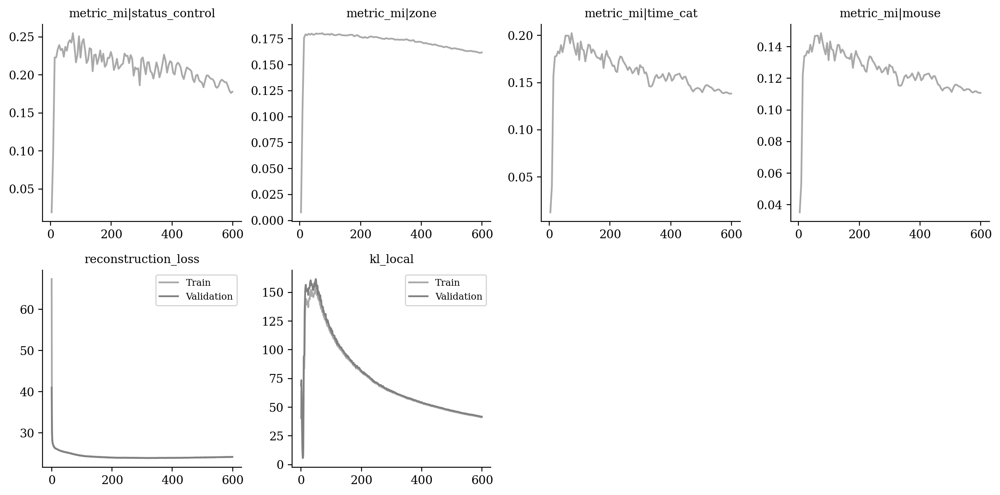

In [15]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [16]:
from tardis._disentanglementmanager import DisentanglementManager as DM

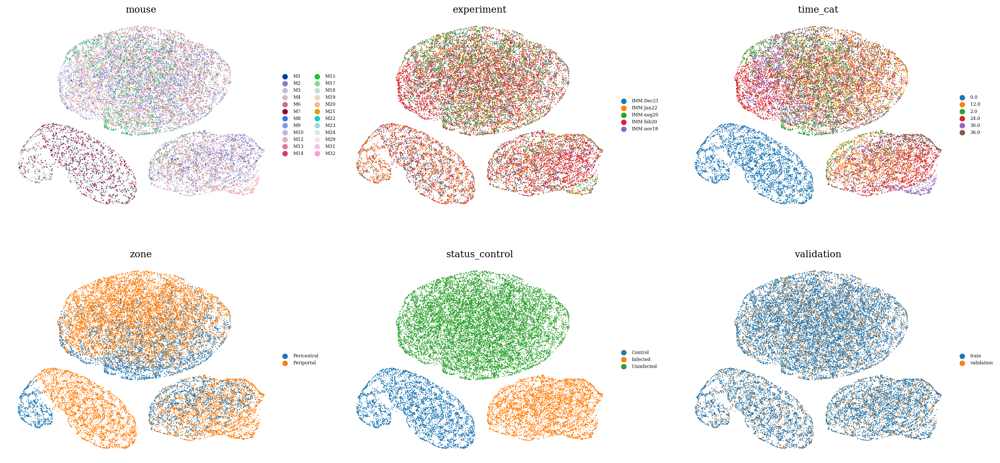

In [17]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

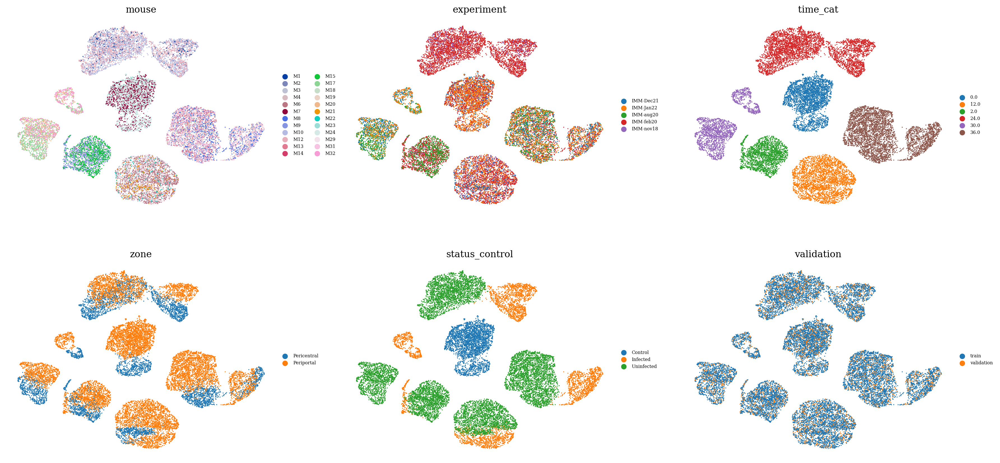

In [18]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

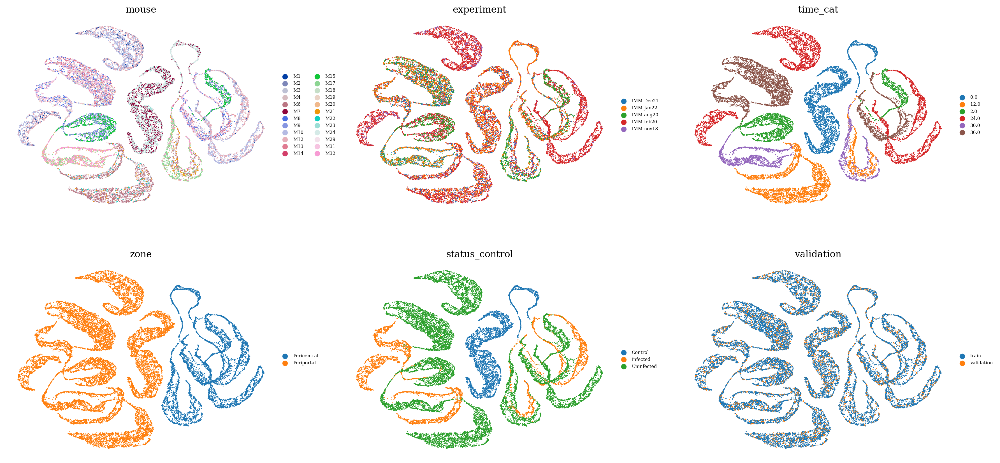

In [19]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

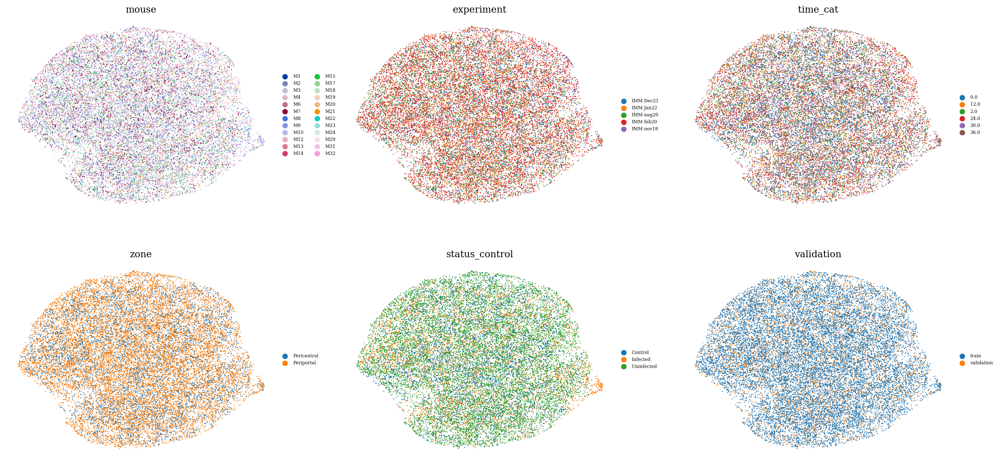

In [20]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

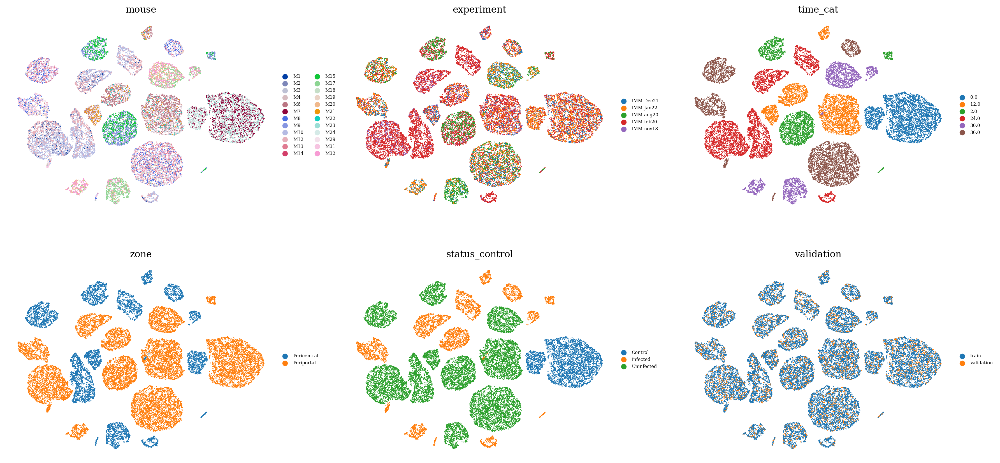

In [21]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [22]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.7924560756498261

In [23]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.7401653061853448

In [24]:
vae.get_MI_normalized_training("zone")

{('validation', 'reserved'): 0.9954631323548185,
 ('validation', 'unreserved'): 0.16723407235384022,
 ('train', 'reserved'): 0.9956857291557539,
 ('train', 'unreserved'): 0.12210766324394826}

In [25]:
vae.get_MI_normalized_training("status_control")

{('validation', 'reserved'): 0.993047881390581,
 ('validation', 'unreserved'): 0.2889535395608521,
 ('train', 'reserved'): 0.9921711763741022,
 ('train', 'unreserved'): 0.23626453821968668}

In [26]:
vae.get_MI_normalized_training("time_cat")

{('validation', 'reserved'): 0.9444841640343601,
 ('validation', 'unreserved'): 0.23148588554975214,
 ('train', 'reserved'): 0.9413233861942711,
 ('train', 'unreserved'): 0.15358801743827666}